# Computer Vision - Midterm project

In [1]:
# Imports
import numpy as np
import cv2
from random import randint

# %matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [2]:
# Create some constants.
PICS_DIR = 'Images/Original/'
PICS_RES_DIR = 'Images/Results/'
DEBUG = True
DISPLAY = True

### Debug functions

In [3]:
def print_debug(*msg, end="\n", sep=" "):

	# Get the DEBUG constant.
	global DEBUG

	if not DEBUG:
		return

	print(sep.join(msg), end=end)

### Functions

In [4]:
def split_channels(img):

	'''
	Split the channels of an image into separate images.
	
	Args:
		img (np.array): The image.

	Return:
		The channels in a tuple.
	'''

	number_of_channels = img.shape[2]

	return tuple([img[:, :, c] for c in range(number_of_channels)])

def merge_channels(channels):

	'''
	Merge the channels of an image into one single image.
	
	Args:
		channels (tuple): A tuple containing the channels to be merged.
		
	Result:
		The resulting image combined.
	'''

	return np.dstack((channels))

def euclidian(a, b):

	'''
	Returns the point-to-point euclidian distances.

	Args:
		a (np.array): Points a [x, y].
		b (np.array): Points b [x, y].

	Return:
		The euclidian distances.
	'''

	return np.sqrt(np.sum((b - a) ** 2))

def convolve(img, kernel, pad=True):

	'''
	Performs a kernel convolution on image img using the kernel.
	
	Args:
		img (np.array):  An image as a numpy array. It is one-dimensional or 3 dimensional.
		kernel (np.array): The kernel that will be used to compute the convolution.
		pad (Boolean): Whether to add padding before convolving or not.

	Return:
		The convolved image.
	'''

	# Get the kernel size.
	kernel_height = kernel.shape[0]
	kernel_width = kernel.shape[1]

	# Get the padding sizes.
	pad_y = kernel_height // 2
	pad_x = kernel_width // 2

	# Apply the padding to the image if it was set to true.
	if pad is True:
		img = np.pad(img, ((pad_y, pad_y), (pad_x, pad_x)), mode='edge')

	# Get the image size.
	img_height = img.shape[0]
	img_width = img.shape[1]

	# Get the convolved image sizes.
	conv_height = img_height - (kernel_height - 1)
	conv_width = img_width - (kernel_width - 1)

	convolved_image = np.zeros((conv_height, conv_width))

	for y in range(kernel_height):
		for x in range(kernel_width):

			# Get the end index.
			# This is the index next to the last one we want to get.
			end_y = img_height - (kernel_height - y) + 1
			end_x = img_width - (kernel_width - x) + 1

			# Get the current submatrix.
			submatrix = img[y:end_y, x:end_x]

			# Add the current submatrix, multiplied by the kernel element.
			convolved_image = convolved_image + (submatrix * kernel[y, x])

			print_debug("\r[Convolving {}, {}]".format(x, y), end="")

	print_debug("\r[Convolved all kernel cells]")

	return convolved_image

def convolve_all_channels(img, kernel, pad=True):

	'''
	Performs a kernel convolution on the N channels of image img using the kernel.
	
	Args:
		img (np.array):  An image as a numpy array. It is one-dimensional or 3 dimensional.
		kernel (np.array): The kernel that will be used to compute the convolution.
		pad (Boolean): Whether to add padding before convolving or not.

	Return:
		The convolved image.
	'''

	# Split the channels.
	channels = split_channels(img)

	# Apply the convolution to all channels.
	channels = [convolve(c, kernel, pad) for c in channels]

	# Join the channels again.
	return merge_channels(channels)

def gaussian_func(x, y, sigma):

	'''
	Calculate the gaussian function for given X, Y and sigma values.
	
	Args:
		x (number): X variable of the gaussian function.
		y (number): Y variable of the gaussian function.
		sigma (number): Sigma constant.

	Return:
		The result of the gaussian function.
	'''

	# Split the formula in two to make it readable.
	gauss1 = 1 / (2 * np.pi * sigma ** 2)

	gauss2 = np.exp(-(x ** 2 + y ** 2) / (2 * sigma ** 2))

	return gauss1 * gauss2


### Color conversions

In [5]:
def color_bgr_to_gray(img):

	'''
	Convert a BGR image to Grayscale.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_bgr_to_rgb(img)

	# Convert RGB to Gray.
	return color_rgb_to_gray(img)

def color_bgr_to_hsl(img):

	'''
	Convert a BGR image to HSL.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_bgr_to_rgb(img)

	# Convert RGB to Gray.
	return color_rgb_to_hsl(img)

def color_bgr_to_hsv(img):

	'''
	Convert a BGR image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_bgr_to_rgb(img)

	# Convert RGB to Gray.
	return color_rgb_to_hsv(img)

def color_bgr_to_rgb(img):

	'''
	Convert a BGR image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Split the channels.
	b, g, r = split_channels(img)

	# Merge them in a different order.
	return merge_channels((r, g, b))

def color_gray_to_bgr(img):

	'''
	Convert a Grayscale image to BGR.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_gray_to_rgb(img)

	return color_rgb_to_bgr(img)

def color_gray_to_hsl(img):

	'''
	Convert a Grayscale image to HSL.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_gray_to_rgb(img)

	return color_rgb_to_hsl(img)

def color_gray_to_hsv(img):

	'''
	Convert a Grayscale image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_gray_to_rgb(img)

	return color_rgb_to_hsv(img)

def color_gray_to_rgb(img):

	'''
	Convert a Grayscale image to RGB.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	return merge_channels((img, img, img))

def color_hsl_to_bgr(img):

	'''
	Convert a HSL image to BGR.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_hsl_to_rgb(img)

	# Convert it to BGR.
	return color_rgb_to_bgr(img)

def color_hsl_to_gray(img):

	'''
	Convert a HSL image to Grayscale.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_hsl_to_rgb(img)

	return color_rgb_to_gray(img)

def color_hsl_to_hsv(img):

	'''
	Convert a HSL image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Uncompress the color.
	hl, sl, ll = split_channels(img.astype(np.float64))

	# Convert it using the formulas on wikipedia.
	hv = hl

	vv = ll + sl * np.min(ll, 1 - ll)

	sv = np.zeros(hv.shape)
	sv[vv == 0] = 2 * (1 - ll[vv == 0] / vv[vv == 0])

	return np.array([hv, sv, vv])

def color_hsl_to_rgb(img):

	'''
	Convert a HSL image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to HSV.
	img = color_hsl_to_hsv(img)

	return color_hsv_to_rgb(img)

def color_hsv_to_bgr(img):

	'''
	Convert a HSV image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_hsv_to_rgb(img)

	return color_rgb_to_bgr(img)

def color_hsv_to_gray(img):

	'''
	Convert a HSV image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to RGB.
	img = color_hsv_to_rgb(img)

	return color_rgb_to_gray(img)

def color_hsv_to_hsl(img):

	'''
	Convert a HSV image to HSL.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Uncompress the color.
	hv, sv, vv = split_channels(img.astype(np.float64))

	# Get the final components.

	# Hue
	h = hv

	# Lightness
	l = vv * (1 - sv / 2)

	# Saturation.
	ind = l == 0 or l == 1
	s = np.zeros(l.shape)
	s[ind] = (vv[ind] - l[ind]) / np.min(l[ind], 1 - l[ind])

	return np.array([h, s, l])

def color_hsv_to_rgb(img):

	'''
	Convert a HSV image to RGB.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.

	See:
		https://www.icaml.org/canon/data/images-videos/HSV_color_space/HSV_color_space.html
	'''

	# Split the channels.
	h, s, v = split_channels(img)

	# Chroma
	c = v * s

	h_partial = h / 60.0
	x = c * (1 - np.abs(h_partial % 2 - 1))

	h_0_1 = np.logical_and(0 <= h_partial, h_partial<= 1)
	h_1_2 = np.logical_and(1 <  h_partial, h_partial<= 2)
	h_2_3 = np.logical_and(2 <  h_partial, h_partial<= 3)
	h_3_4 = np.logical_and(3 <  h_partial, h_partial<= 4)
	h_4_5 = np.logical_and(4 <  h_partial, h_partial<= 5)
	h_5_6 = np.logical_and(5 <  h_partial, h_partial<= 6)

	rgb_tmp = np.zeros_like(img)
	
	z = np.zeros_like(h)

	rgb_tmp[h_0_1] = np.dstack((c[h_0_1], x[h_0_1], z[h_0_1]))  
	rgb_tmp[h_1_2] = np.dstack((x[h_1_2], c[h_1_2], z[h_1_2]))
	rgb_tmp[h_2_3] = np.dstack((z[h_2_3], c[h_2_3], x[h_2_3]))
	rgb_tmp[h_3_4] = np.dstack((z[h_3_4], x[h_3_4], c[h_3_4]))
	rgb_tmp[h_4_5] = np.dstack((x[h_4_5], z[h_4_5], c[h_4_5]))
	rgb_tmp[h_5_6] = np.dstack((c[h_5_6], z[h_5_6], x[h_5_6]))

	m = v - c

	final = rgb_tmp + merge_channels((m, m, m))

	# Convert everything to a proper image.
	return np.round(final * 255).astype('uint8')

def color_rgb_to_bgr(img):

	'''
	Convert a RGB image to BGR.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Uncompress it.
	r, g, b = split_channels(img)

	# Recompress it.
	return merge_channels((b, g, r))

def color_rgb_to_gray(img):

	'''
	Convert a BGR image to Gray.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Split the channels.
	r, g, b = split_channels(img.astype(int))

	# Return the average of them 3.
	return ((r + g + b) // 3).astype('uint8')

def color_rgb_to_hsl(img):

	'''
	Convert a RGB image to HSL.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.
	'''

	# Convert it to HSV.
	img = color_rgb_to_hsv(img)

	return color_hsv_to_hsl(img)

def color_rgb_to_hsv(img):

	'''
	Convert a RGB image to HSV.

	Args:
		img (np.array): The image as a numpy array in the aforementioned color model.
	
	Return:
		The image as a numpy array in the resulting color model.

	See:
		https://www.icaml.org/canon/data/images-videos/HSV_color_space/HSV_color_space.html
	'''

	img_norm = img.astype(np.float64) / 255.0

	# Split the channels.
	r, g, b = split_channels(img_norm)

	v_max = np.max(img_norm, axis=2)
	v_min = np.min(img_norm, axis=2)
	
	chroma = v_max - v_min									  
	
	hue_gtz = chroma > 0
	
	# Check which is the maximum component on each case.
	r_max_ind = np.logical_and(r == v_max, hue_gtz)
	g_max_ind = np.logical_and(g == v_max, hue_gtz)
	b_max_ind = np.logical_and(b == v_max, hue_gtz)
	
	# Hue
	h = np.zeros_like(v_max)
	h_r = ((g[r_max_ind] - b[r_max_ind]) / chroma[r_max_ind]) % 6
	h_g = ((b[g_max_ind] - r[g_max_ind]) / chroma[g_max_ind]) + 2
	h_b = ((r[b_max_ind] - b[b_max_ind]) / chroma[b_max_ind]) + 4
	
	h[r_max_ind] = h_r
	h[g_max_ind] = h_g
	h[b_max_ind] = h_b
	h *= 60
	
	# Value
	v = v_max

	sat_gtz = v > 0
	
	# Saturation.
	s = np.zeros_like(v_max)
	s[sat_gtz] = chroma[sat_gtz] / v[sat_gtz]
	
	return merge_channels((h, s, v))

### Display & store functions

In [6]:
def display_photos(org_img, filtered_img):

	'''
	Display the images using Matplotlib.
	
	Args:
		org_img (np.array): Original image to display on the left side of the plot.
		filtered_img (np.array): Image after applying the filter to display on the right side.
	'''

	if not DISPLAY:
		return

	fig, axis = plt.subplots(1, 2)
	fig.tight_layout()

	axis[0].imshow(org_img)
	axis[1].imshow(filtered_img)
	
	plt.show()

def display_photos_3(img1, img2, img3):

	'''
	Display the images using Matplotlib.
	
	Args:
		img1 (np.array): Image to be displayed.
		img2 (np.array): Image to be displayed.
		img3 (np.array): Image to be displayed.
	'''

	if not DISPLAY:
		return

	fig, axis = plt.subplots(1, 3)
	fig.tight_layout()

	axis[0].imshow(img1)
	axis[1].imshow(img2)
	axis[1].imshow(img3)
	
	plt.show()

def display_photos_4(img1, img2, img3, img4):

	'''
	Display the images using Matplotlib.
	
	Args:
		img1 (np.array): Image to be displayed.
		img2 (np.array): Image to be displayed.
		img3 (np.array): Image to be displayed.
		img4 (np.array): Image to be displayed.
	'''

	if not DISPLAY:
		return

	fig, axis = plt.subplots(2, 2)
	fig.tight_layout()

	axis[0, 0].imshow(img1)
	axis[0, 1].imshow(img2)
	axis[1, 0].imshow(img3)
	axis[1, 1].imshow(img4)
	
	plt.show()

def display_photos_8(img1, img2, img3, img4, img5, img6, img7, img8):

	'''
	Display the images using Matplotlib.
	
	Args:
		img1 (np.array): Image to be displayed.
		img2 (np.array): Image to be displayed.
		img3 (np.array): Image to be displayed.
		img4 (np.array): Image to be displayed.
		img5 (np.array): Image to be displayed.
		img6 (np.array): Image to be displayed.
		img7 (np.array): Image to be displayed.
		img8 (np.array): Image to be displayed.
	'''

	if not DISPLAY:
		return

	fig, axis = plt.subplots(4, 2)
	fig.tight_layout()

	axis[0, 0].imshow(img1)
	axis[0, 1].imshow(img2)
	axis[1, 0].imshow(img3)
	axis[1, 1].imshow(img4)
	axis[2, 0].imshow(img5)
	axis[2, 1].imshow(img6)
	axis[3, 0].imshow(img7)
	axis[3, 1].imshow(img8)
	
	plt.show()

def store_picture(img, part, fil, num, val=None, ext='png'):

	'''
	Store the image in the Results folder, with an ordered name.
	
	Args:
		img (np.array): RGB image to be stored.
		part (int): Project section in which this image has been obtained.
		fil (str): Filter name.
		num (int): Number of the image.
		ext (str): File extension.
	'''

	# Normalize the filter name.
	fil = fil.lower()
	fil = fil.replace(' ', '_')

	# Build the resulting name.
	res_name = 'part_{}_fil_{}_n_{}'.format(part, fil, num)

	# If a value was passed, add it to the name.
	if val is not None:
		res_name += '_v_{}'.format(val)

	# Convert the image to BGR because CV2 uses this format.
	bgr_img = color_rgb_to_bgr(img)

	cv2.imwrite(PICS_RES_DIR + res_name + '.' + ext, bgr_img)

## Part 1: Photo effects

### Saturation boost

In [7]:
def saturation_apply_scale(img, scale):

	'''
	Scale the saturation channel of an HSL image img by the scale float.
	
	Args:
		img (np.array): An HSL image.
		scale (float):  An scaling float.
		
	Return:
		The image after modifying its saturation channel.
	'''

	# Convert the image to HSV.
	img_hsv = color_rgb_to_hsv(img)

	# Split the channels.
	h, s, v = split_channels(img_hsv)

	# Multiply the Saturation channel by the scale we decided.
	# We need to clip values that are out of range.
	s =  np.minimum(s * scale, np.ones_like(s))

	# Join the channels again.
	img_hsv = merge_channels((h, s, v))

	# Convert it back to RGB and return it.
	return color_hsv_to_rgb(img_hsv)

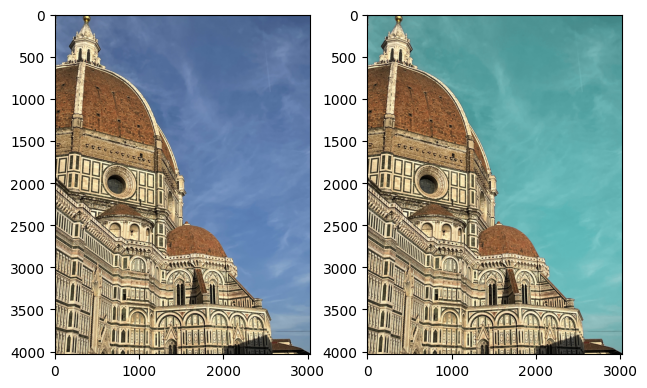

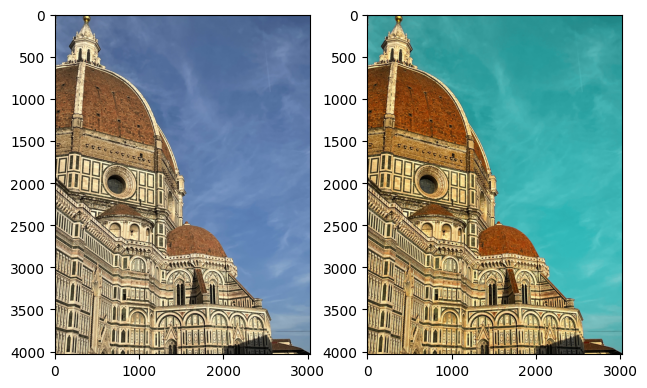

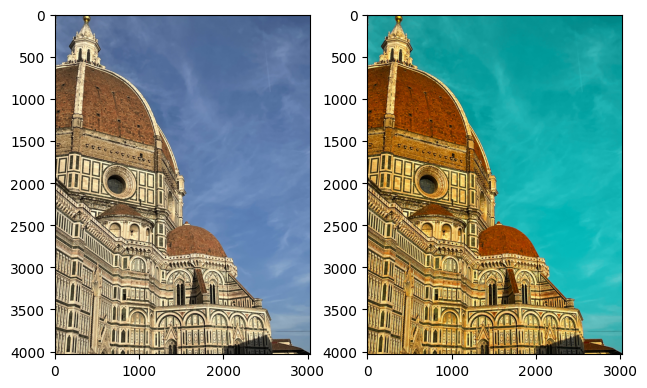

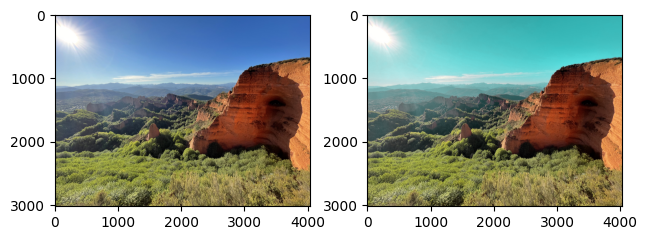

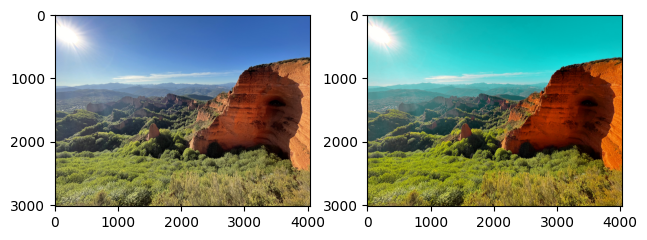

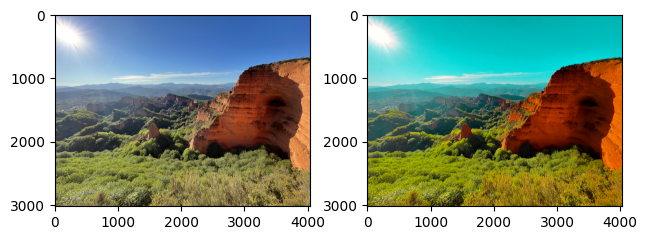

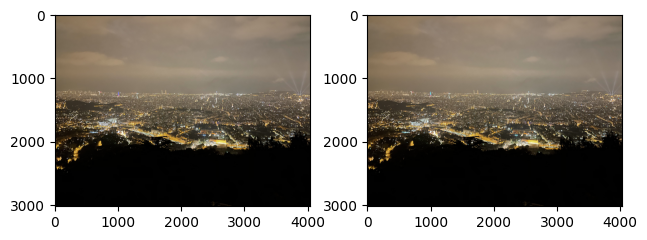

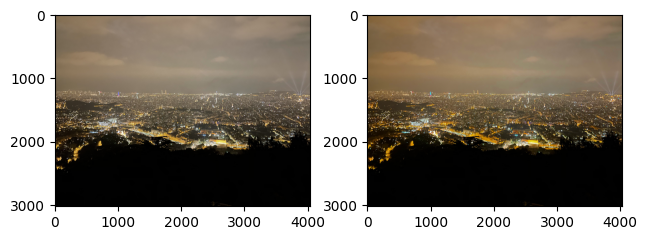

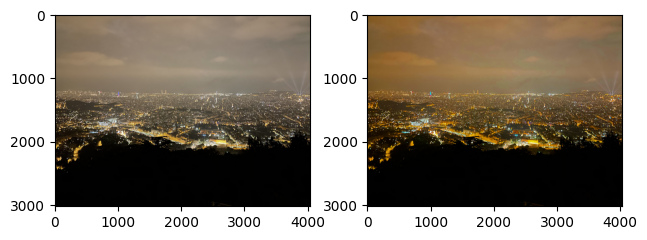

In [8]:
# Get the information for this experiment.
PART = 1
FILTER_NAME = 'Saturation boost'
IMAGES = ['florencia_catedral.png', 'medulas.png', 'barcelona_skyline.png']

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Apply 3 values.
	for scale in [1.0, 1.5, 2.0]:

		# Apply the filter.
		fil_img = saturation_apply_scale(org_img, scale)

		# Store it.
		store_picture(fil_img, PART, FILTER_NAME, num, val=scale)

		# Display them.
		display_photos(org_img, fil_img)

### Duotone

In [9]:
def duotone(img, color1, color2):

	'''
	Apply a duotone effect to the image.
	
	Args:
		img (np.array): A grayscale image.
		color1 (np.array):  'Shadows' RGB color.
		color2 (np.array):  'Lights' RGB color.
		
	Return:
		The image after applying the duotone.

	See:
		https://helpx.adobe.com/ie/photoshop/how-to/add-duotone-color-effect.html
	'''

	# Convert the image to gray.
	img = color_rgb_to_gray(img)

	# Normalize the image.
	img_norm = img / 255

	# Push the extrems to 0 and 1.
	img_norm = img_norm - np.min(img_norm)
	img_norm = img_norm / np.max(img_norm)

	# The basic formula for interpolation is n1 + (n2 - n1) * step.
	# We will do this with NumPy.

	# Create two images of pure color1 and pure color2.
	img_color1 = np.ones((img.shape[0], img.shape[1], color1.shape[0]), int)
	img_color1 *= np.array(color1, dtype='uint8')

	img_color2 = np.ones((img.shape[0], img.shape[1], color2.shape[0]), int)
	img_color2 *= np.array(color2, dtype='uint8')

	# Apply the interpolation function.
	step = merge_channels((img_norm, img_norm, img_norm))
	return np.array(color1 + (color2 - color1) * step, dtype='uint8')

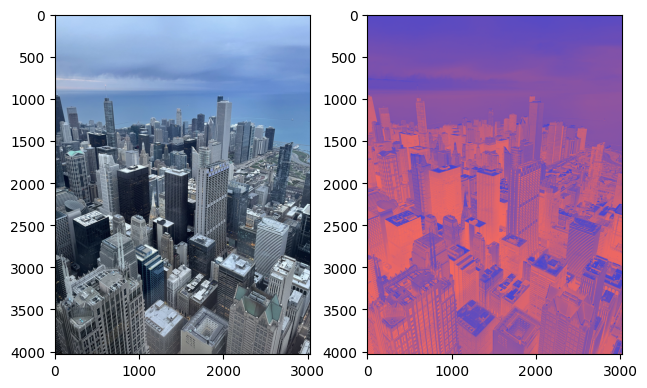

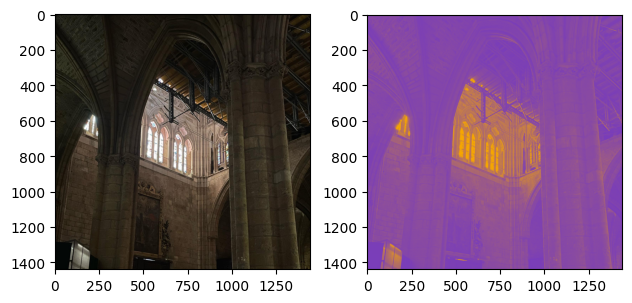

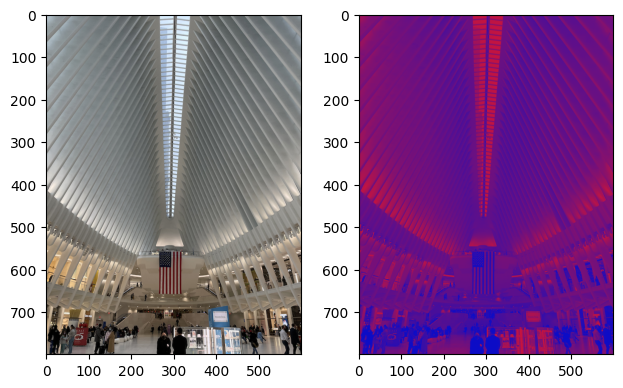

In [10]:
# Get the information for this experiment.
PART = 1
FILTER_NAME = 'Duotone'
IMAGES = ['chicago_downtown_high.png', 'leon_catedral_interior.png', 'nyc_intercambiador_crop.png']
COLORS = [
	[[252, 107, 91], [56, 68, 217]],
	[[120, 60, 189], [247, 168, 0]],
	[[12, 12, 200], [208, 21, 56]]
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Apply the filter.
	fil_img = duotone(org_img, np.array(COLORS[num][0]), np.array(COLORS[num][1]))

	# Store it.
	store_picture(fil_img, PART, FILTER_NAME, num)

	# Display them.
	display_photos(org_img, fil_img)

### Stained glass

In [11]:
def stained_glass(img, pnts):

	'''
	Apply a stained glass effect.
	
	Args:
		img (np.array): An RGB image.
		pnts (int): The number of generating points in the stained glass effect.

	Return:
		An image after applying the stained glass effect.
	'''

	# Get the dimensions. We do not mind the depth. It will be handled by func.
	height = img.shape[0]
	width = img.shape[1]

	# Get the position of the generating points.
	gen_points = np.array([(randint(0, height), randint(0, width)) for x in range(pnts)])

	# Get all X and Y pixel indices in an array.
	# This means that pixel_indices[Y, X] = [Y, X].
	pixel_indices = np.indices((height, width))
	pixel_indices = merge_channels((pixel_indices[0], pixel_indices[1]))

	# Init the datastructure to store the closest point yet and the minimum distance.
	closest_labels = np.zeros((height, width))
	minimum_distances = np.matrix(np.ones((height, width)) * np.inf)

	# Iterate by all the generating points.
	for i, gen in enumerate(gen_points):

		# Now get the euclidian distance from each pixel in the image to the gen point.
		# We can do this using NumPy.
		gen_distances = np.sum((pixel_indices - gen) ** 2, axis=2)

		# Everywhere where this distance is shorter than the current minimum distance, get indices.
		change_labels = gen_distances < minimum_distances

		# Use those indexes to store the new minimum distances and minimum labels.
		closest_labels[change_labels] = i
		minimum_distances[change_labels] = gen_distances[change_labels]

		print_debug("\r[Processing gen_point {}/{}]".format(i, len(gen_points)), end="")

	print_debug("\r[Processed all gen_points]")

	# Init the return variable.
	ret_img = np.zeros_like(img)

	# Iterate by all the generating points.
	# Now all the points in closest_labels have been correctly set.
	for i, gen in enumerate(gen_points):

		# Get all the colors summed and all the label counts to compute the average color of the
		# area.
		area_ind = closest_labels == i
		avg_colors = np.mean(img[area_ind], axis=(0))

		# Get the average color and put in on all those positions of ret_img corresponding to those
		# pixels.
		ret_img[area_ind] = avg_colors

		print_debug("\r[Recolouring gen_point {}/{}]".format(i, len(gen_points)), end="")

	print_debug("\r[Recolouring all gen_points]")

	return ret_img


[Processed all gen_points]1000]
[Recolouring all gen_points]000]


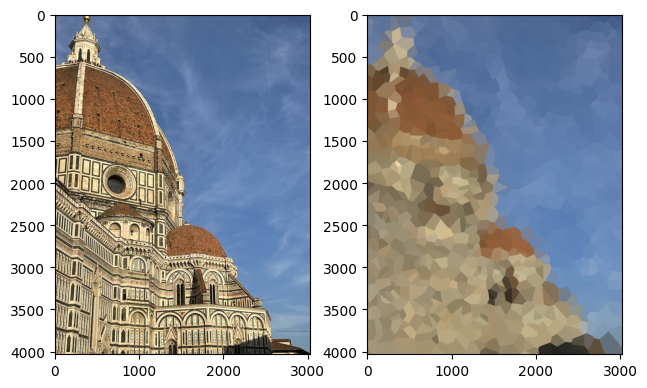

[Processed all gen_points]1000]
[Recolouring all gen_points]000]


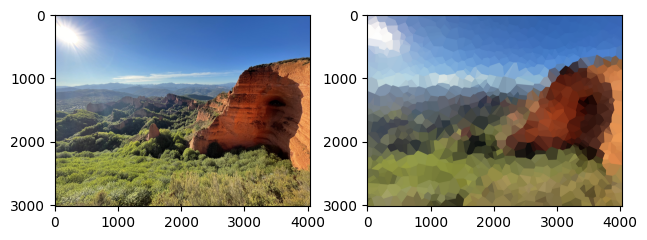

[Processed all gen_points]1000]
[Recolouring all gen_points]000]


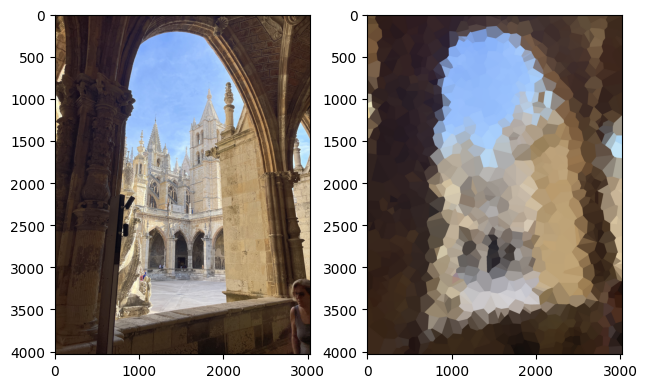

In [12]:
# Get the information for this experiment.
PART = 1
FILTER_NAME = 'Stained glass'
IMAGES = ['florencia_catedral.png', 'medulas.png', 'leon_catedral_portico.png']

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.


	# QUITAR.
	# TODO DEVELOPMENT.
	# org_img = cv2.resize(org_img, (org_img.shape[1] // 12, org_img.shape[0] // 12), interpolation = cv2.INTER_AREA)


	# Apply the filter.
	fil_img = stained_glass(org_img, 1000)

	# Store it.
	store_picture(fil_img, PART, FILTER_NAME, num)

	# Display them.
	display_photos(org_img, fil_img)

### Embossing

In [13]:
def emboss(img, kernel_size):

	'''
	Implements an emboss filter in n-dimensions.

	Args:
		img (np.array): An RGB image.
		kernel_size (number): Size of the kernel to be generated.

	Returns:
		The resulting image after applying the convolution.
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if kernel_size % 2 == 0:
		kernel_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(kernel_size))

	# Generate the kernel.
	kernel = np.zeros((kernel_size, kernel_size))
	k_x, k_y = np.indices((kernel_size, kernel_size)) - (kernel_size // 2)

	# The diagonal line is made of 2s.
	kernel[k_x == k_y] = 2

	# The horizontal & vertical lines are composed of 1.
	kernel[k_x == 0] = 1
	kernel[k_y == 0] = 1

	# Values on the top left part are negative.
	kernel[np.logical_or(k_y < 0, k_x < 0)] *= -1

	# Detect if it is 1-dimensional or n-dimensional.
	if len(img.shape) == 2:

		# Convolve the image as a simple 1-channel image.
		ret_image = convolve(img, kernel)

	else:

		# For each channel, convolve it.
		channels = split_channels(img)

		# Convolve the image channels as a simple 1-channel image.
		channels_conv = [convolve(chan, kernel) for chan in channels]

		# Join the channels.
		ret_image = merge_channels(channels_conv)

	# Clip the image.
	ret_image = np.round(ret_image)
	ret_image[ret_image > 255] = 255
	ret_image[ret_image < 0] = 0

	return ret_image.astype('uint8')

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


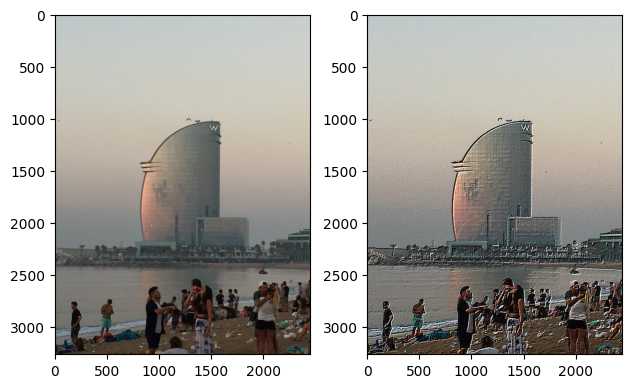

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


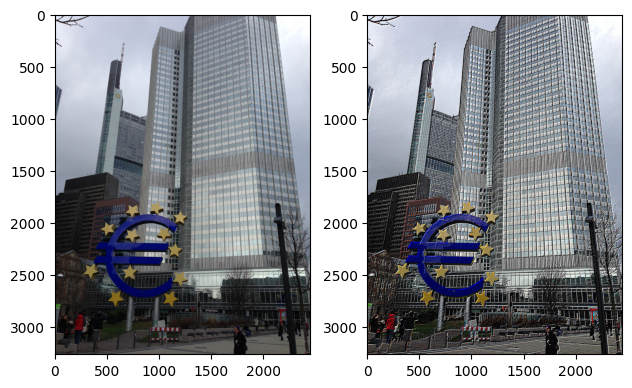

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


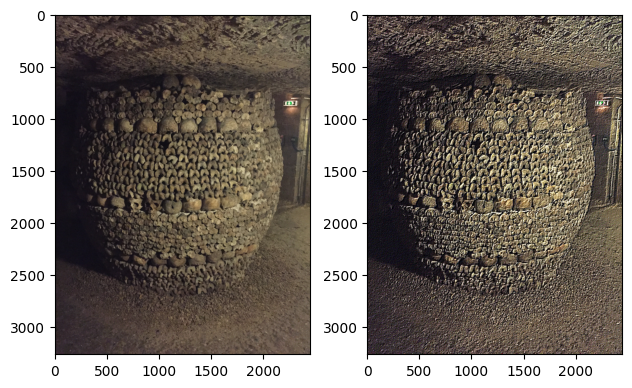

In [14]:
# Get the information for this experiment.
PART = 1
FILTER_NAME = 'Emboss'
IMAGES = ['hotel_vela.png', 'francfort_bce.png', 'paris_catacumbas.png']

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Apply the filter.
	fil_img = emboss(org_img, 5)

	# Store it.
	store_picture(fil_img, PART, FILTER_NAME, num)

	# Display them.
	display_photos(org_img, fil_img)

### Yoakumization

In [15]:
def bilateral_filter(img, kernel_size, sig_r, sig_s):

	'''
	Implements a bilateral filter.

	Args:
		img (np.array): An RGB image.
		kernel_size (number): Size of the kernel that will be used to compute the convolution.
		sig_r (number): Sigma constant of the gaussian function f_r.
		sig_s (number): Sigma constant of the gaussian function g_s.

	Returns:
		The resulting image after applying the convolution.

	See:
		https://en.wikipedia.org/wiki/Bilateral_filter
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if kernel_size % 2 == 0:
		kernel_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(kernel_size))

	# Convert the image to int64 to avoid clipping problems.
	img = img.astype(np.int64)

	# Get a copy of the image that will be used as the original image.
	org_img = img.copy()

	# Pad the image to avoid errors.
	# To do this we use half the size of the kernel, as it is the further away it'll go.
	img = np.pad(img, pad_width=kernel_size // 2, mode='edge')

	# Get the image dimensions.
	img_height = img.shape[0]
	img_width = img.shape[1]

	# Get the convolved image sizes.
	conv_height = img_height - (kernel_size - 1)
	conv_width = img_width - (kernel_size - 1)
	
	# Init the resulting image.
	result = np.zeros((conv_height, conv_width))

	# Init the W_p normalizer accumulator.
	w_p = 0

	# Iterate through the kernel cells.
	for x in range(kernel_size):
		for y in range(kernel_size):

			# Get the end index.
			# This is the index next to the last one we want to get.
			end_y = img_height - (kernel_size - y) + 1
			end_x = img_width - (kernel_size - x) + 1

			# Get the current submatrix.
			submatrix = img[y:end_y, x:end_x]

			# Get the two matrix components from the bilateral function.
			f_r = gaussian_func(submatrix - org_img, 0, sig_r)
			g_s = gaussian_func(euclidian(np.array([x, y]),
					np.array([kernel_size // 2, kernel_size // 2])), 0, sig_s)
			
			# Calculate the W_p normalizer.
			modifier = f_r * g_s

			# Apply the kernel and spatial and modifiers.
			result = result + (submatrix * modifier)

			# Apply the W_p summatory.
			w_p += modifier

	# Normalize the image.
	result = result // w_p

	return result.astype('uint8')

In [16]:
def yoakumization(img, levels, bilateral_size, sigma1, sigma2):

	'''
	Apply a cartoon effect to the image.

	Args:
		img (np.array): An RGB image.
		levels (int): Number of quantization levels.
		bilateral_size (number): Bilateral filter size that will be applied.
		sigma1 (number): Bilateral filter sigma 1 that will be applied.
		sigma2 (number): Bilateral filter sigma 2 that will be applied.

	Return:
		An image after applying the stained glass effect.
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if bilateral_size % 2 == 0:
		bilateral_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(bilateral_size))

	# Apply a bilateral filter to remove textures.
	channels = split_channels(img)
	channels = [bilateral_filter(c, bilateral_size, sigma1, sigma2) for c in channels]
	smooth_image = merge_channels(channels)

	# Get the quantization size.
	step = 255 // levels

	# Apply a quantization filter to the image.
	img_quant = (smooth_image // step) * step

	# Get the outlining kernel.
	kernel = np.array([
		[ 1,  1,  1],
		[ 1, -8,  1],
		[ 1,  1,  1]
	])
	outlined = convolve_all_channels(img_quant, kernel, True)
	outlined[outlined > 255] = 255
	outlined[outlined < 0] = 0

	# Convert it to black and white cause we only care abut lines themselves.
	outlined = color_rgb_to_gray(outlined).astype('float32')

	# Threshold it.
	outlined[outlined < 10] = 0
	outlined[outlined >= 10] = 0.5

	# Invert it to use it as a mask.
	outlined = 1 - outlined

	# Multiply the outline by the quantization.
	ret_img =  img_quant.astype('float32') * merge_channels((outlined, outlined, outlined))

	# Round it to have proper values.
	ret_img = np.round(ret_img)
	
	# Convolve it to get a filter to avoid heavy aliasing.
	# Get the outlining kernel.
	kernel = np.array([
		[ 0,  1,  0],
		[ 1,  4,  1],
		[ 0,  1,  0]
	])
	ret_img = convolve_all_channels(ret_img, kernel, True)
	ret_img = ret_img // np.sum(kernel)

	return ret_img.astype('uint8')

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


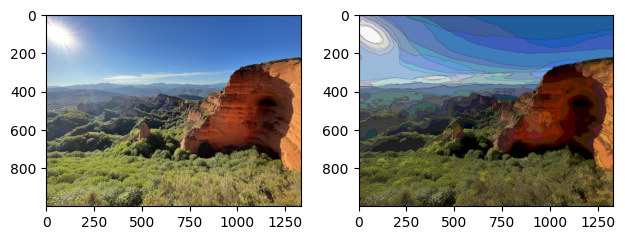

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


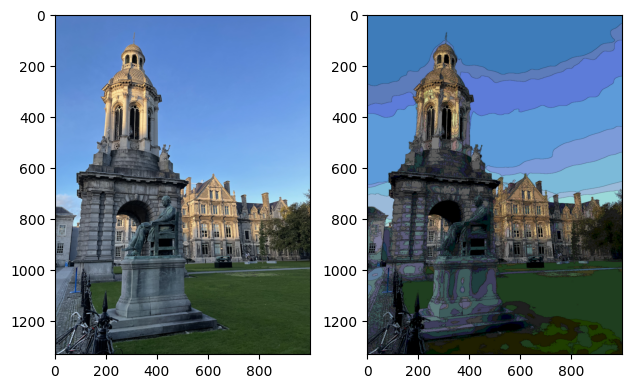

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


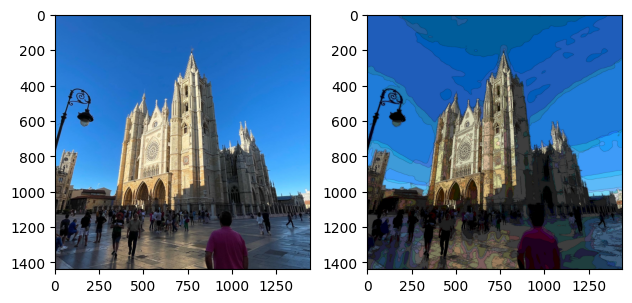

In [17]:
# Get the information for this experiment.
PART = 1
FILTER_NAME = 'Yoakumization'
IMAGES = ['medulas_crop.png', 'trinity_day_crop.png', 'leon_catedral_exterior.png']

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Apply the filter.
	fil_img = yoakumization(org_img, 8, 31, 30, 15)

	# Store it.
	store_picture(fil_img, PART, FILTER_NAME, num)

	# Display them.
	display_photos(org_img, fil_img)

## Part 2: Sharpening, blur, and noise removal

### Median filter

In [18]:
def median_filter(img, kh, kw):

	'''
	Apply a Median blur effect to the image img.
	
	Args:
		img (np.array): An RGB image.
		kh (int): The to-be-generated kernel height.
		kw (int): The to-be-generated kernel width.

	Return:
		An image after applying the gaussian blur.
	'''

	# Generate the kernel from the specified arguments.
	kernel = np.ones((kh, kw))

	# Convert the image to uint64 to avoid overflows.
	img = img.astype('uint64')

	# Convolve the image using the kernel.
	result_img = convolve_all_channels(img, kernel, True)

	# Normalize the image.
	result_img = result_img // np.sum(kernel)

	return result_img.astype('uint8')

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


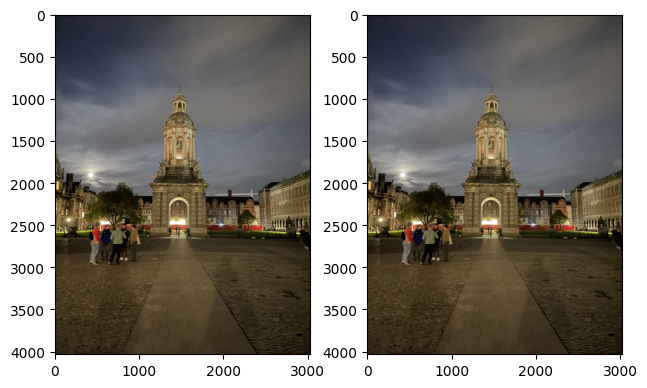

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


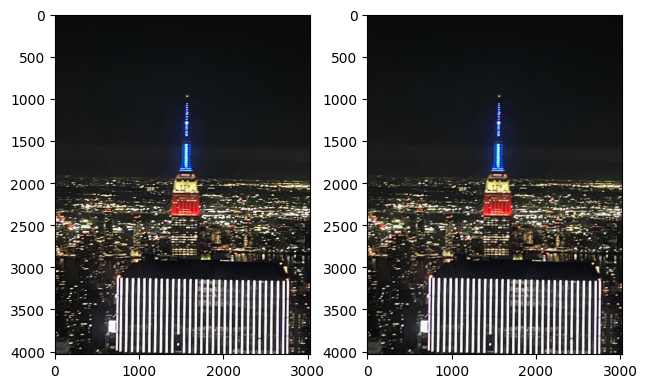

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


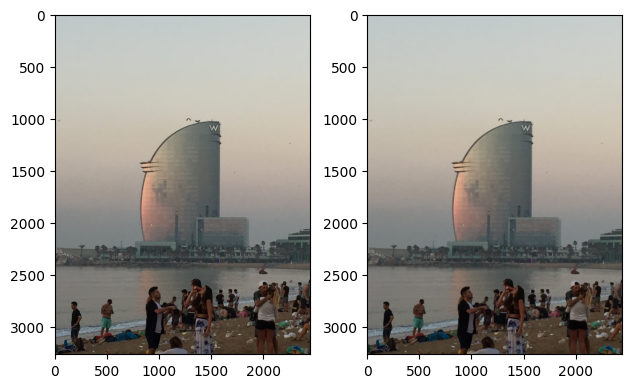

In [19]:
# Get the information for this experiment.
PART = 2
FILTER_NAME = 'Median filter'
IMAGES = ['trinity_noche.png', 'empire_state_bad.png', 'hotel_vela.png']
KERNELS_SIZES = [
	[3, 3],
	[9, 3],
	[7, 7]
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Apply the filter.
	fil_img = median_filter(org_img, KERNELS_SIZES[num][0], KERNELS_SIZES[num][1])

	# Store it.
	store_picture(fil_img, PART, FILTER_NAME, num)

	# Display them.
	display_photos(org_img, fil_img)

### Gaussian blur

In [20]:
def gaussian_blur(img, kh, kw, sigma):

	'''
	Apply a Gaussian blur effect to the image img.
	
	Args:
		img (np.array): An RGB image.
		kh (int): The to-be-generated kernel height.
		kw (int): The to-be-generated kernel width.
		sigma (number): Sigma constant.

	Return:
		An image after applying the gaussian blur.
	'''

	# Generate the gaussian kernel from the specified arguments.
	gauss_y, gauss_x = np.indices((kh, kw), dtype='float64')
	gauss_y -= kh // 2
	gauss_x -= kw // 2
	kernel = gaussian_func(gauss_x, gauss_y, sigma)

	# Normalize the kernel to integers.
	# kernel = (kernel // np.min(kernel)).astype('uint64')

	# Convert the image to uint64 to avoid overflows.
	img = img.astype('float64')

	# Convolve the image using the kernel.
	result_img = convolve_all_channels(img, kernel, True)

	# Normalize the image.
	result_img = result_img // np.sum(kernel)

	return result_img.astype('uint8')

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


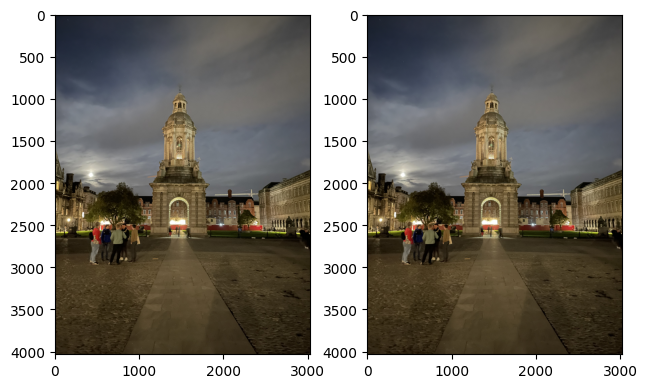

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


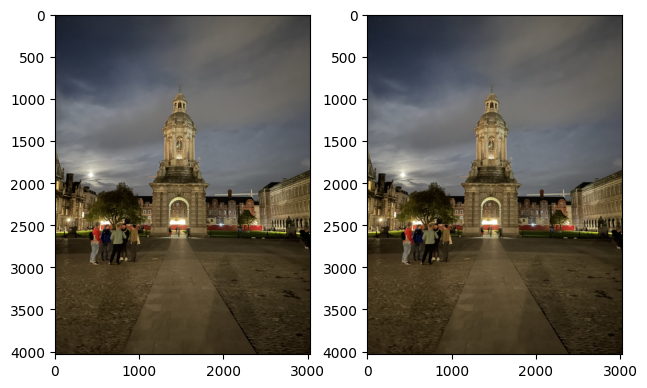

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


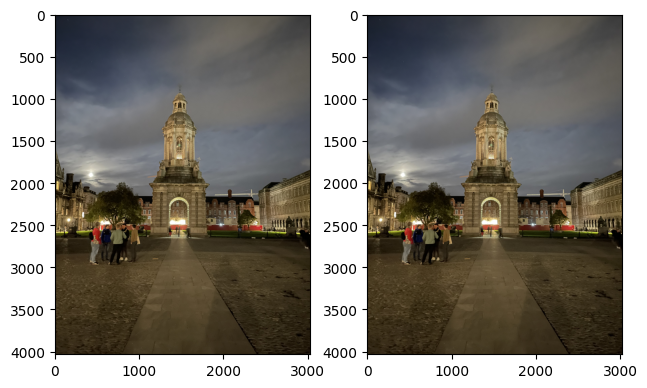

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


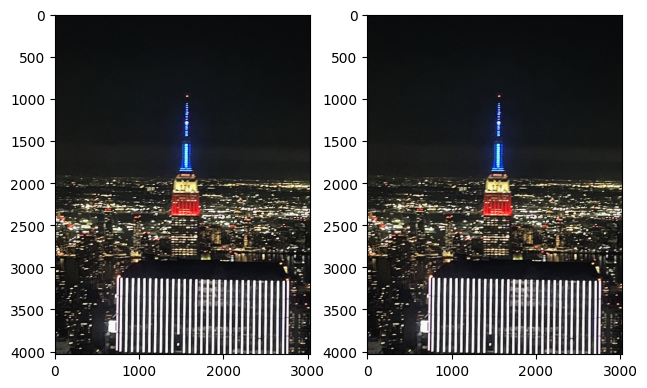

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


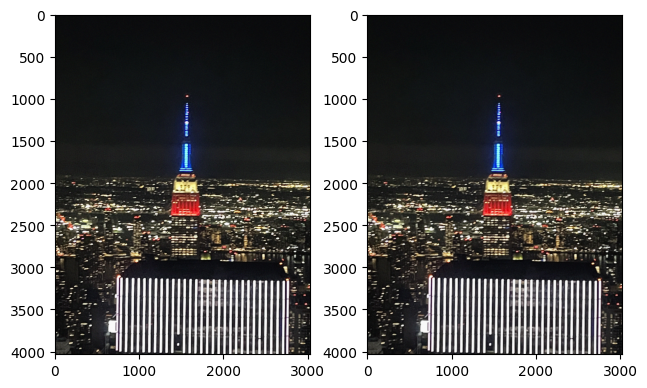

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


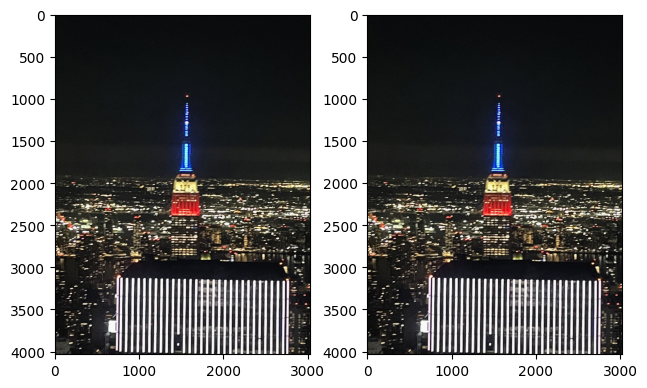

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


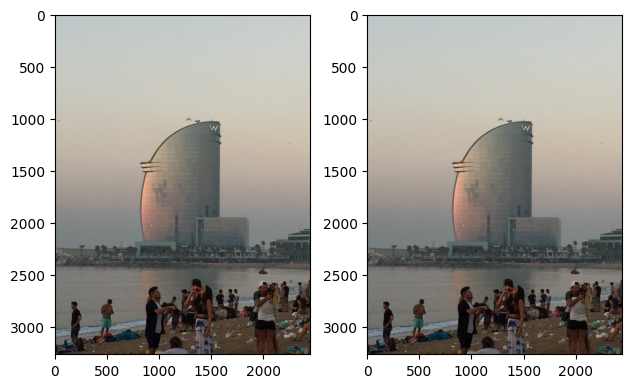

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


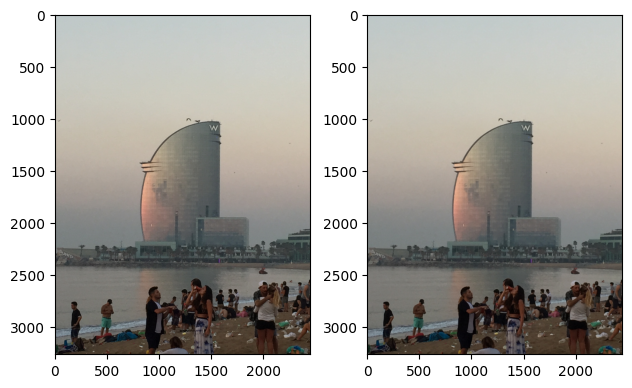

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


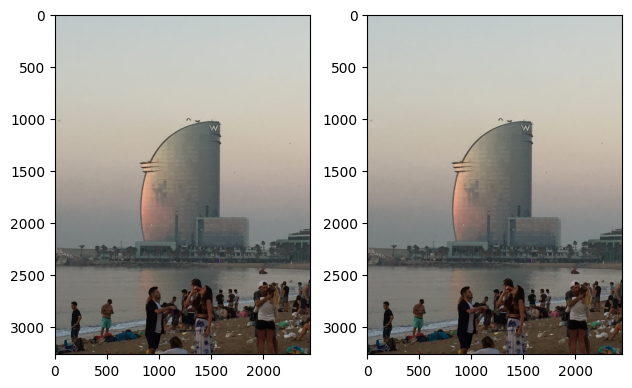

In [21]:
# Get the information for this experiment.
PART = 2
FILTER_NAME = 'Gaussian blur'
IMAGES = ['trinity_noche.png', 'empire_state_bad.png', 'hotel_vela.png']
PARAMS = [
	[
		[5, 5, 1],
		[5, 5, 5],
		[10, 10, 0.5]
	],
	[
		[5, 5, 1],
		[5, 5, 5],
		[10, 10, 0.5]
	],
	[
		[5, 5, 1],
		[5, 5, 5],
		[10, 10, 0.5]
	]
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	for it in range(3):

		# Get the parameters.
		kh = PARAMS[num][it][0]
		kw = PARAMS[num][it][1]
		sigma = PARAMS[num][it][2]

		# Apply the filter.
		fil_img = gaussian_blur(org_img, kh, kw, sigma)

		# Store it.
		store_picture(fil_img, PART, FILTER_NAME, num, val='{}_{}_{}'.format(kh, kw, sigma))

		# Display them.
		display_photos(org_img, fil_img)

### Bilateral filtering

In [22]:
def apply_bilateral_filter(img, kernel_size, sig_r, sig_s):

	'''
	Applies a bilateral filter to all channels.

	Args:
		img (np.array): An RGB image.
		kernel_size (number): Size of the kernel that will be used to compute the convolution.
		sig_r (number): Sigma constant of the gaussian function f_r.
		sig_s (number): Sigma constant of the gaussian function g_s.

	Returns:
		The resulting image after applying the convolution.

	See:
		https://en.wikipedia.org/wiki/Bilateral_filter
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if kernel_size % 2 == 0:
		kernel_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(kernel_size))

	# Get the channels.
	channels = split_channels(img)

	# Apply the bilateral_filter.
	channels = [bilateral_filter(c, kernel_size, sig_r, sig_s) for c in channels]

	# Merge them and return it.
	return merge_channels(channels)

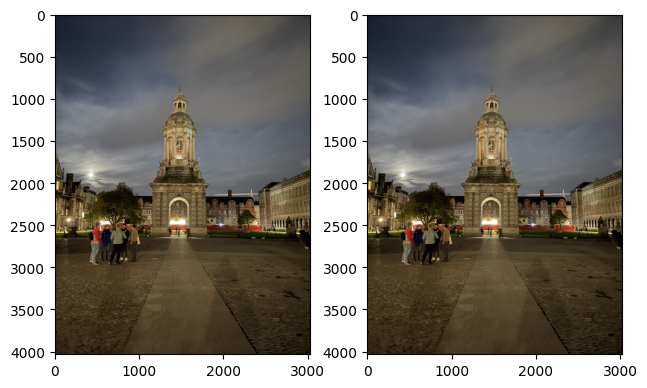

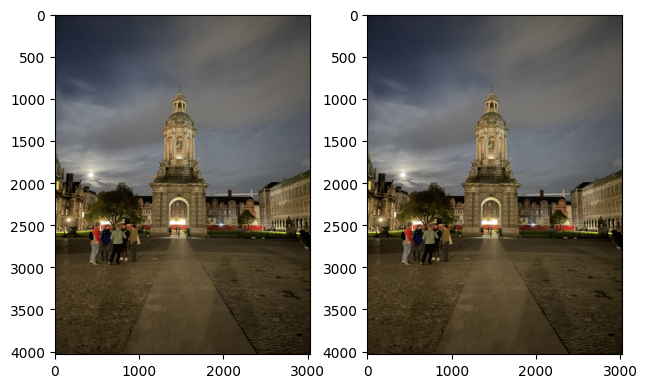

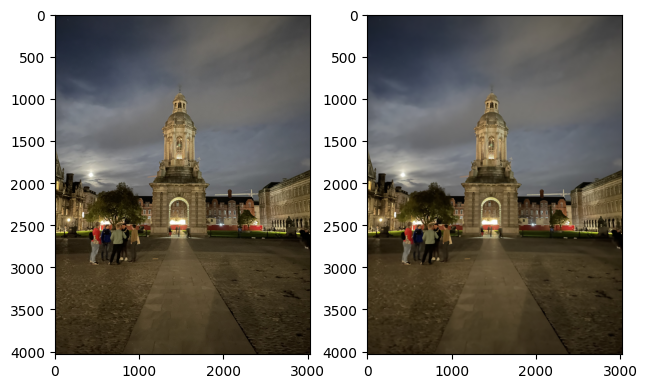

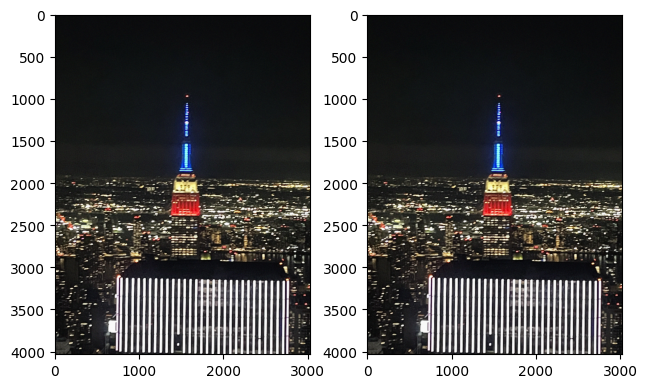

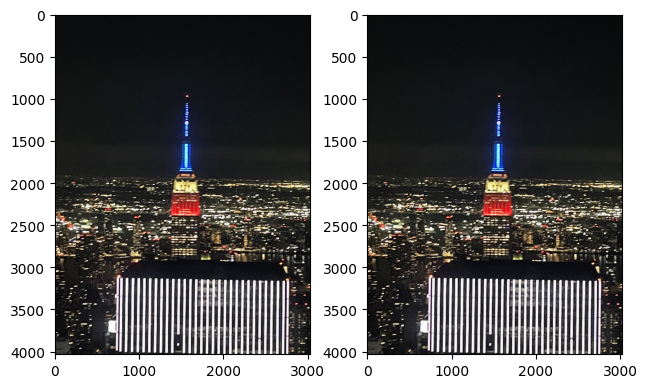

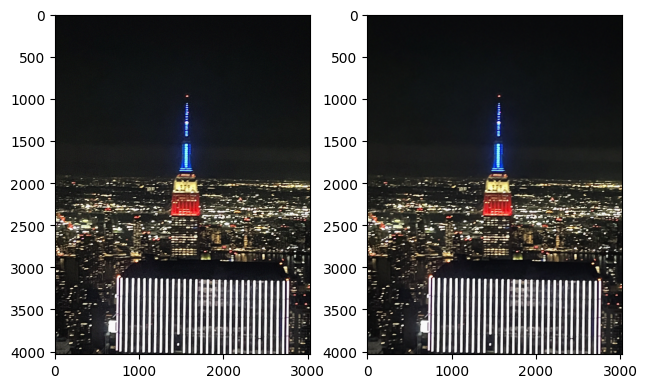

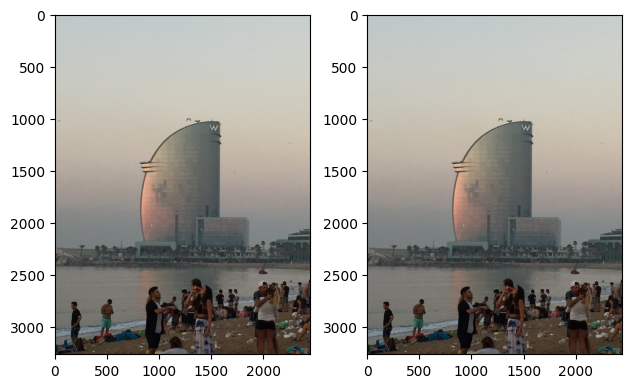

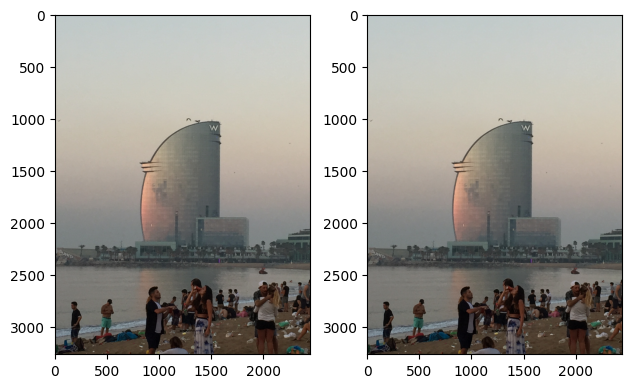

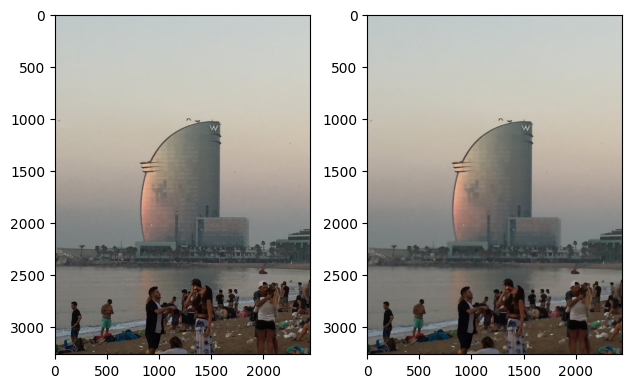

In [23]:
# Get the information for this experiment.
PART = 2
FILTER_NAME = 'Bilateral filter'
IMAGES = ['trinity_noche.png', 'empire_state_bad.png', 'hotel_vela.png']
PARAMS = [
	[
		[5, 5.0, 1.0],
		[5, 1.0, 5.0],
		[21, 20.0, 10.0]
	],
	[
		[5, 5.0, 1.0],
		[5, 1.0, 5.0],
		[21, 20.0, 10.0]
	],
	[
		[5, 5.0, 1.0],
		[5, 1.0, 5.0],
		[21, 20.0, 10.0]
	]
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	for it in range(3):

		# Get the parameters.
		size = PARAMS[num][it][0]
		sigma_r = PARAMS[num][it][1]
		sigma_s = PARAMS[num][it][2]

		# Apply the filter.
		fil_img = apply_bilateral_filter(org_img, size, sigma_r, sigma_s)

		# Store it.
		store_picture(fil_img, PART, FILTER_NAME, num, val='{}_{}_{}'.format(size, sigma_r, sigma_s))

		# Display them.
		display_photos(org_img, fil_img)

### Bartlett filter

In [24]:
def bartlett_filter(img, kernel_size):

	'''
	Applies a Bartlett filter to all channels.

	Args:
		img (np.array): An RGB image.
		kernel_size (number): Size of the kernel that will be used to compute the convolution.

	Returns:
		The resulting image after applying the convolution.

	See:
		https://research.cs.wisc.edu/graphics/Courses/559-f2002/lectures/cs559-7.ppt
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if kernel_size % 2 == 0:
		kernel_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(kernel_size))

	# Get the kernel central index.
	kernel_center = kernel_size // 2

	# Get the generators for the kernel. The kernel will be the result of multiplying both arrays.
	kernel_gen = [(kernel_center + 1) - abs(i - kernel_center) for i in range(kernel_size)]
	kernel_gen_1 = np.array([kernel_gen for i in range(kernel_size)])
	kernel_gen_2 = np.transpose(kernel_gen_1)

	# Get the final kernel.
	kernel = kernel_gen_1 * kernel_gen_2

	# Convolve all channels using this kernel.
	ret_img = convolve_all_channels(img.astype('uint64'), kernel, True)

	# Normalize the image.
	ret_img = ret_img // np.sum(kernel)

	return ret_img.astype('uint8') 

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


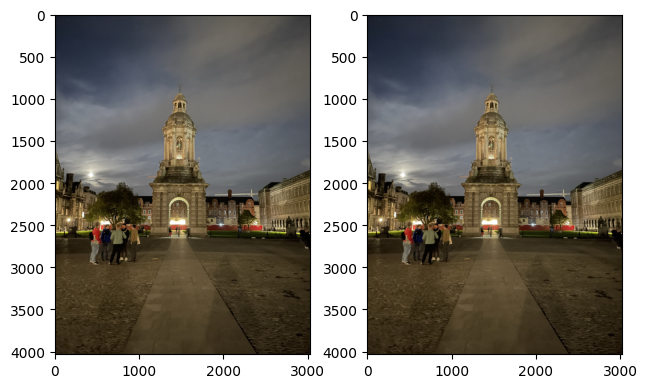

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


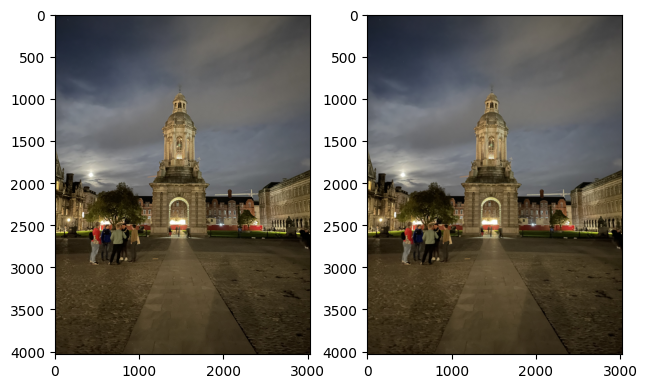

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


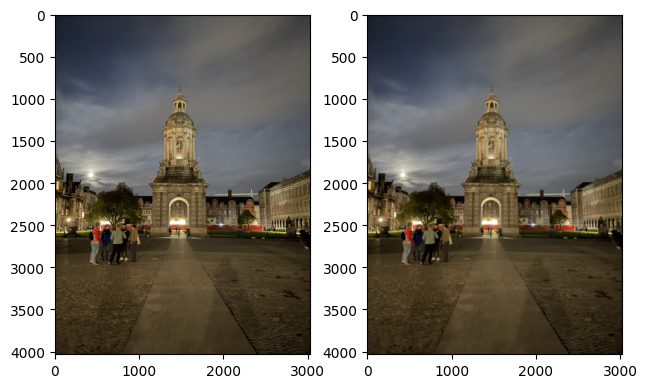

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


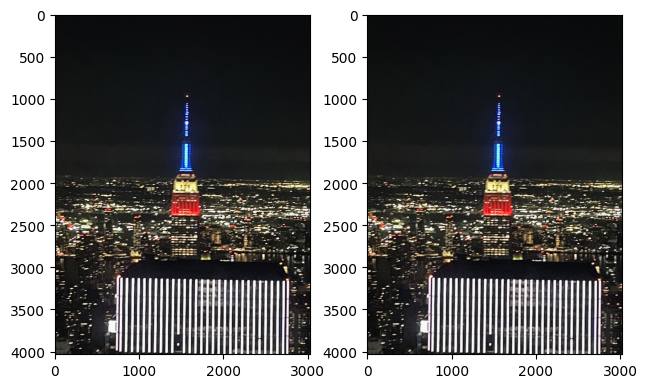

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


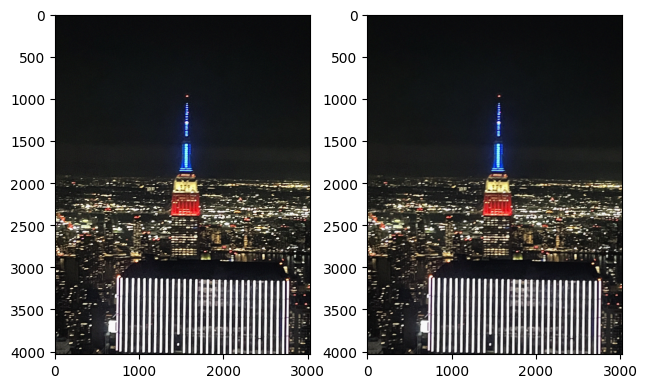

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


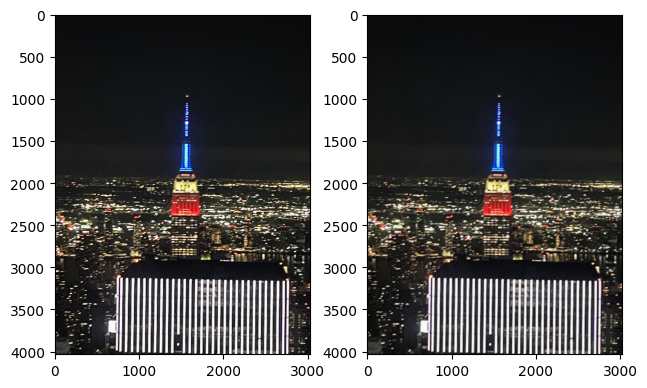

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


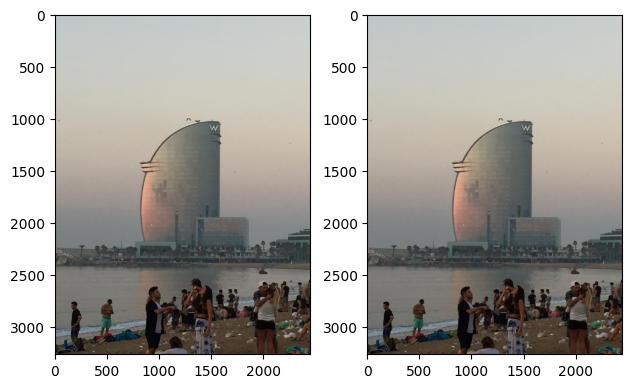

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


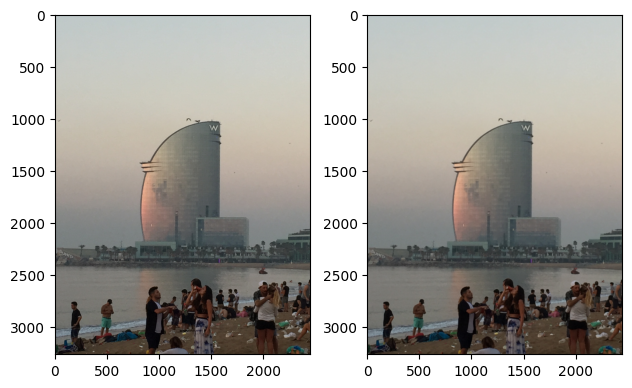

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


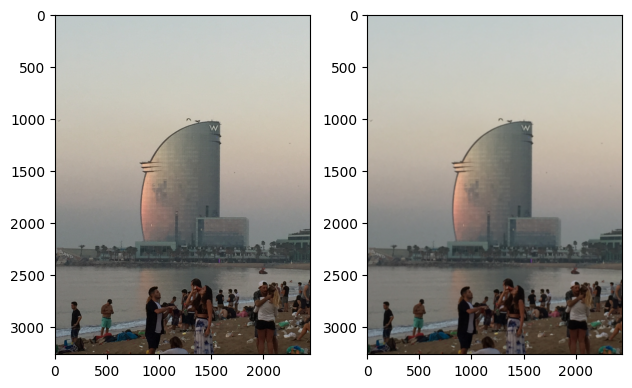

In [25]:
# Get the information for this experiment.
PART = 2
FILTER_NAME = 'Bartlett filter'
IMAGES = ['trinity_noche.png', 'empire_state_bad.png', 'hotel_vela.png']
PARAMS = [
	[5, 9, 15],
	[5, 9, 15],
	[5, 9, 15]
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	for it in range(3):

		# Apply the filter.
		fil_img = bartlett_filter(org_img, PARAMS[num][it])

		# Store it.
		store_picture(fil_img, PART, FILTER_NAME, num, val='{}'.format(PARAMS[num][it]))

		# Display them.
		display_photos(org_img, fil_img)

### Unsharp mask

In [26]:
def unsharp_mask(img, kw, kh):

	'''
	Applies a Unsharp masking sharpening effect on all channels.

	Args:
		img (np.array): An RGB image.
		kh (int): The to-be-generated kernel height.
		kw (int): The to-be-generated kernel width.

	Returns:
		The resulting image after applying the convolution.

	See:
		https://homepages.inf.ed.ac.uk/rbf/HIPR2/unsharp.htm
		https://en.wikipedia.org/wiki/Unsharp_masking
	'''

	# Generate the kernel.

	# The unsharp masking kernel is the result of operating with two kernels: the 'cross' and the
	# identity kernel.

	# Get the kernel indexes we will use to operate.
	ind_y, ind_x = np.indices((kh, kw), dtype='float64')

	# Get the identity and cross kernels.
	identity_kernel = np.zeros((kh, kw))
	identity_kernel[np.logical_and(ind_y == kh //2, ind_x == kw // 2)] = 1

	cross_kernel = np.zeros((kh, kw))
	cross_kernel[np.logical_or(ind_y == kh //2, ind_x == kw // 2)] = 1

	# Get the desired kernel by operating with these.
	cross_sum = np.sum(cross_kernel)
	kernel = identity_kernel + (identity_kernel - cross_kernel / cross_sum) * cross_sum
	kernel = np.round(kernel).astype('int8')

	# Convolve all channels using this kernel.
	ret_image = convolve_all_channels(img.astype('int64'), kernel, True)

	# Clip the image.
	ret_image[ret_image > 255] = 255
	ret_image[ret_image < 0] = 0

	return ret_image.astype('uint8')

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


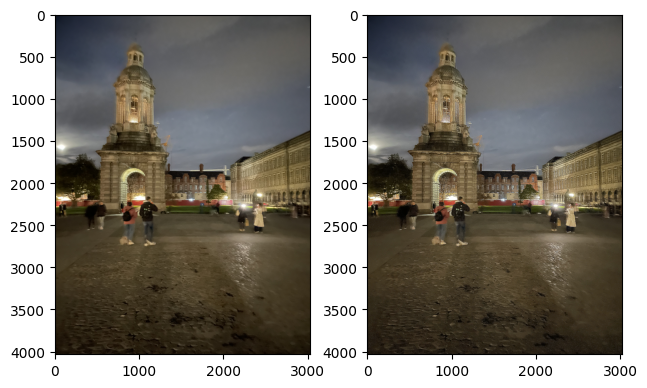

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


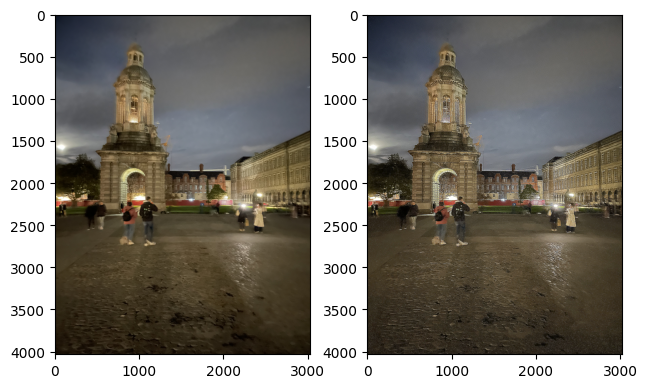

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


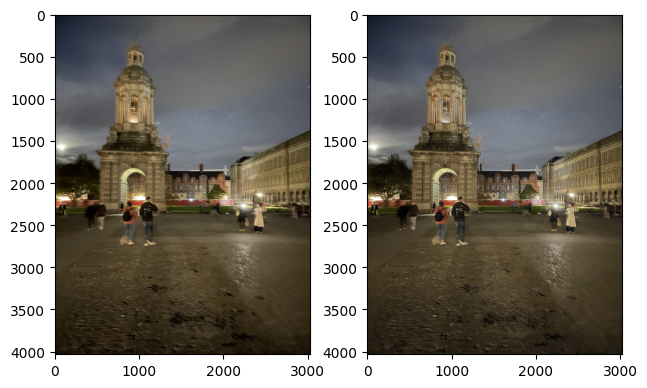

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


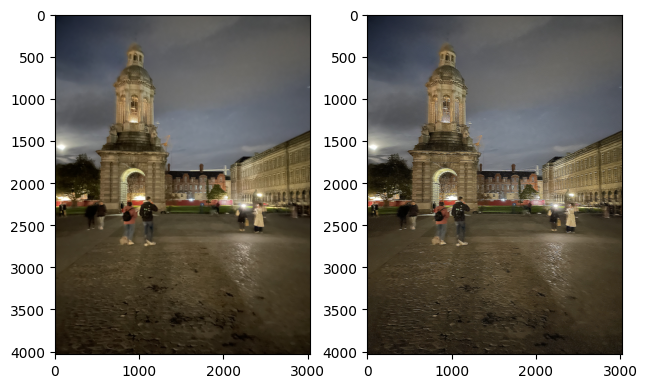

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


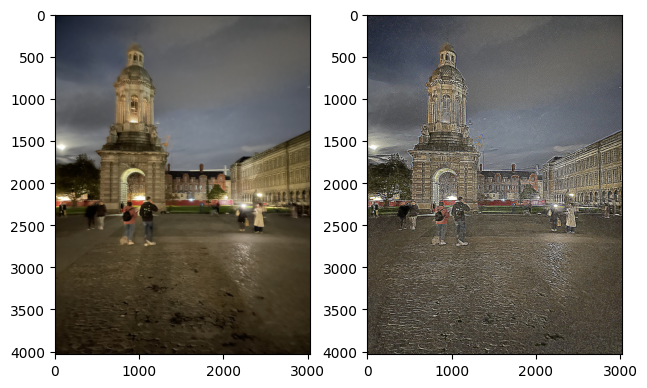

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


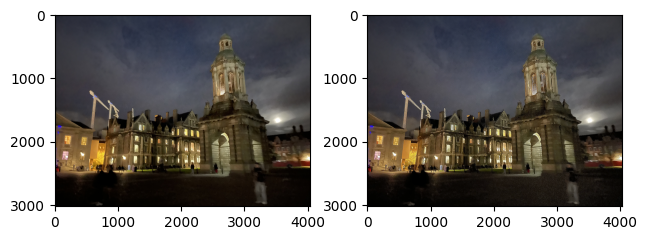

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


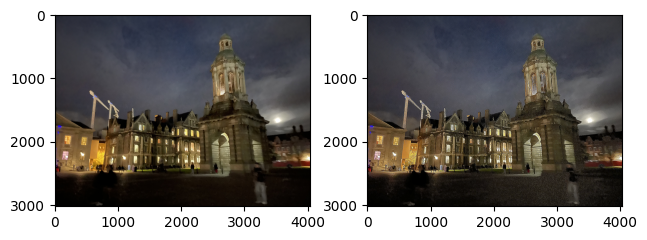

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


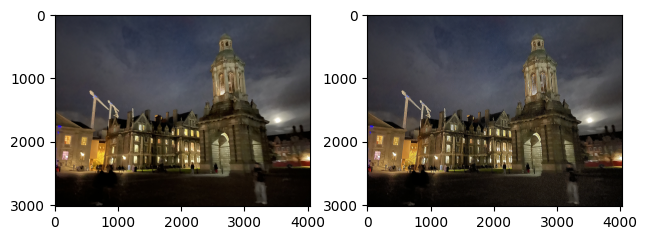

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


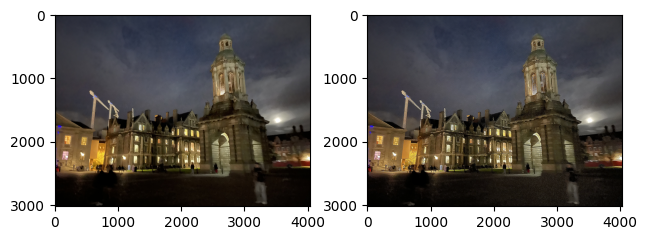

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


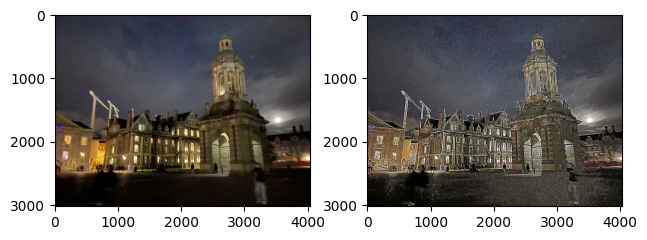

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


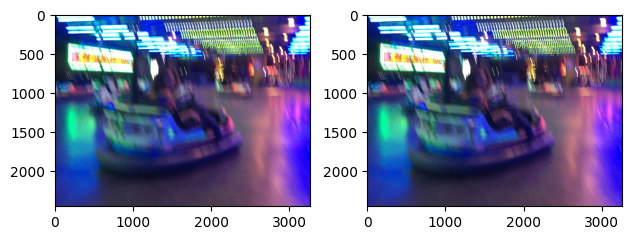

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


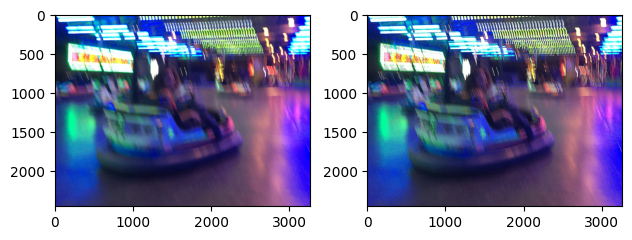

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


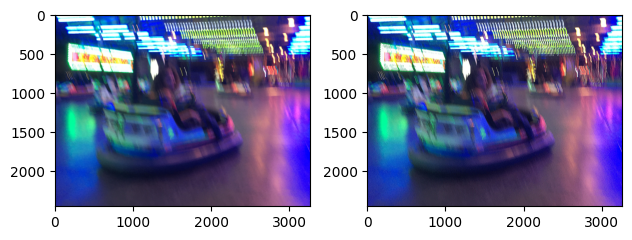

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


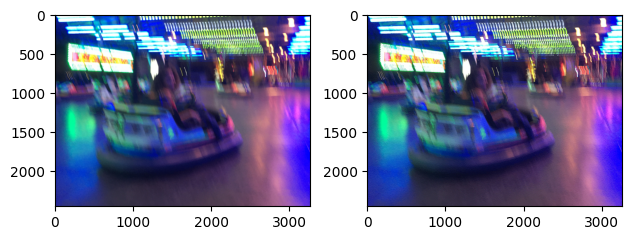

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


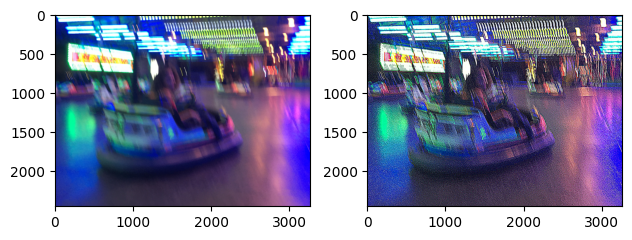

In [27]:
# Get the information for this experiment.
PART = 2
FILTER_NAME = 'Unsharp mask'
IMAGES = ['trinity_noche_movida.png', 'trinity_noche_movida_2.png', 'auto_de_choque.png']
PARAMS = [
	[
		[5, 5],
		[7, 7],
		[7, 3],
		[3, 7],
		[15, 15]
	],
	[
		[5, 5],
		[7, 7],
		[7, 3],
		[3, 7],
		[15, 15]
	],
	[
		[5, 5],
		[7, 7],
		[7, 3],
		[3, 7],
		[15, 15]
	],
]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	for it in range(len(PARAMS[num])):

		# Get the params.
		kh = PARAMS[num][it][0]
		kw = PARAMS[num][it][1]

		# Apply the filter.
		fil_img = unsharp_mask(org_img, kh, kw)

		# Store it.
		store_picture(fil_img, PART, FILTER_NAME, num, val='{}_{}'.format(kh, kw))

		# Display them.
		display_photos(org_img, fil_img)

## Part 3: High-quality image resampling

### Rescaling helper functions

In [28]:
def decimate(img, keep_every):

	'''
	Decimate an image by only keeping one every keep_every rows and columns of the original image.
	
	Args:
		img (np.array): The original image to resample.
		keep_every (int): The number that will be used to determine what cells to keep.
	
	Return:
		The image after dropping the unwanted columns and rows.
	'''

	# Do it for every channel if it is multi-channel.
	if len(img.shape) == 3:

		# Split the channels, recursively to it and return the combination.
		channels = split_channels(img)
		dec_channels = [decimate(ch, keep_every) for ch in channels]
		return merge_channels(dec_channels)

	# Get the original shape of the image and tranform it into the desired shape.
	shape = list(img.shape)
	shape[0] = shape[0] // keep_every
	shape[1] = shape[1] // keep_every

	# Directly drop excess to avoid numpy complaints.
	img = img[0:shape[0] * keep_every, 0:shape[1] * keep_every]

	# Create an empty matrix of the desired shape.
	# We will use this to repeat the original contents of the image n times.
	img_dec = np.zeros(shape, dtype=img.dtype)

	# Get the indices of the image. This will allow us to operate with the assignation.
	ind_y, ind_x = np.indices((img.shape[0], img.shape[1]), dtype='uint64')

	img_dec[img_dec == 0] = img[np.logical_and(ind_y % keep_every == 0, ind_x % keep_every == 0)]

	return img_dec

def upscale(img, repeat):

	'''
	Upscale the image by repeating n-times each row and column.
	
	Args:
		img (np.array): The original image to resample.
		keep_every (int): The number that will be used to determine how many times the rows /
				columns will be repeated.
	
	Return:
		The image after repeating the rows and columns.
	'''

	# Do it for every channel if it is multi-channel.
	if len(img.shape) == 3:

		# Split the channels, recursively to it and return the combination.
		channels = split_channels(img)
		up_channels = [upscale(ch, repeat) for ch in channels]
		return merge_channels(up_channels)

	# Get the original shape of the image and tranform it into the desired shape.
	shape = list(img.shape)
	shape[0] *= repeat
	shape[1] *= repeat

	# Create an empty matrix of the desired shape.
	# We will use this to repeat the original contents of the image n times.
	img_upscaled = np.zeros(shape, dtype=img.dtype)

	# Get the indices of the matrix. This will allow us to operate with the assignation.
	ind_y, ind_x = np.indices((shape[0], shape[1]))

	# We will iterate to get each subcell in the NxN squares of repetition.
	# Finally, assign the values of the image to all the corresponding cells.
	for y in range(repeat):
		for x in range(repeat):
			
			img_upscaled[np.logical_and(ind_y % repeat == y, ind_x % repeat == x)] = img.flatten()

	return img_upscaled

### Linear decimation

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


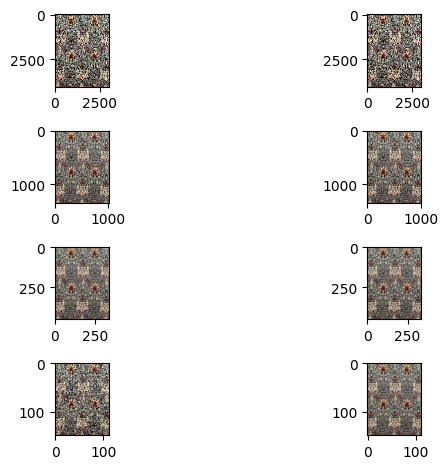

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


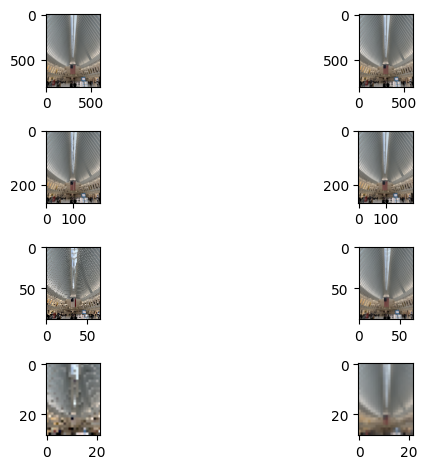

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


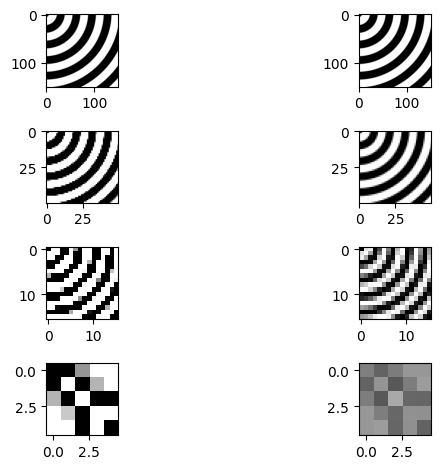

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


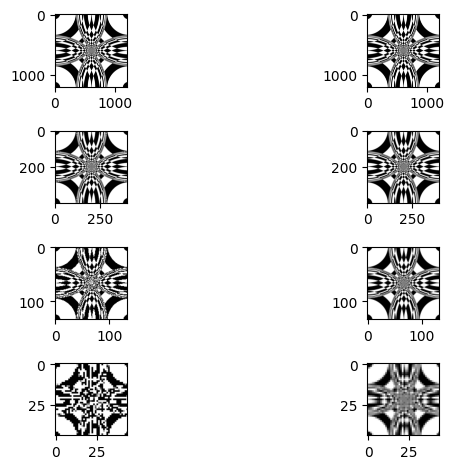

In [29]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Linear decimation'
IMAGES = ['chicago_fabric.png', 'nyc_intercambiador_crop.png',
		'img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png',
		'img_1200x1200_1x8bit_T01L01_GRAY_grid_circles_progressive_b.png']
PARAMS = [3, 9, 27]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Create the two lists to store the images.
	decms = [org_img.copy()]
	convs = [org_img.copy()]

	for sz in (PARAMS):

		# Just decimate to test.
		dec_img = decimate(org_img, sz)
		decms += [dec_img.copy()]

		# Apply the filter and then decimate.
		fil_img = median_filter(org_img, sz, sz)
		fil_img = decimate(fil_img, sz)

		convs += [fil_img.copy()]

		# Store it.
		store_picture(dec_img.copy(), PART, FILTER_NAME, num, val='dec_{}'.format(sz))

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='conv_{}'.format(sz))

	# Display them.
	display_photos_8(decms[0], convs[0], decms[1], convs[1], decms[2], convs[2], decms[3], convs[3])

### Binomial decimation

In [30]:
def pascal_triangle(n):

	'''
	Return the bionomial coefficients for a given row number in the pascal triangle.
	
	Args:
		n (int): Row number or also number of coefficients.
		
	Return:
		A list containing the coefficients.
	'''

	# If n is 1 or smaller, return 1 as if it was 1.
	if n <= 1:
		return [1]

	# Get the coefficients for n-1.
	prev_coeffs = pascal_triangle(n - 1)

	# Get the central part.
	central_part = [prev_coeffs[i - 1] + prev_coeffs[i] for i in range(1, len(prev_coeffs))]

	# Append two ones and return it.
	return [1] + central_part + [1]

def binomial_filter(img, kernel_size):

	'''
	Applies a Binomial filter to all channels.

	Args:
		img (np.array): An RGB image.
		kernel_size (number): Size of the kernel that will be used to compute the convolution.

	Returns:
		The resulting image after applying the convolution.

	See:
		https://research.cs.wisc.edu/graphics/Courses/559-f2002/lectures/cs559-7.ppt
	'''

	# Make sure the kernel size is an odd number. Otherwise, make it odd by adding one and print a
	# warning.
	if kernel_size % 2 == 0:
		kernel_size += 1
		print_debug('Kernel size must be odd. The value used will be {}'.format(kernel_size))

	# Get the bionomial coefficients for this kernel size.
	kernel_gen = np.array([pascal_triangle(kernel_size)])

	# Convert them into two nxn arrays. One vertical and one horizontal.
	kernel = np.dot(np.transpose(kernel_gen), kernel_gen)

	# Convolve all channels using this kernel.
	ret_img = convolve_all_channels(img.astype('uint64'), kernel, True)

	# Normalize the image.
	ret_img = ret_img // np.sum(kernel)

	return ret_img.astype('uint8') 

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


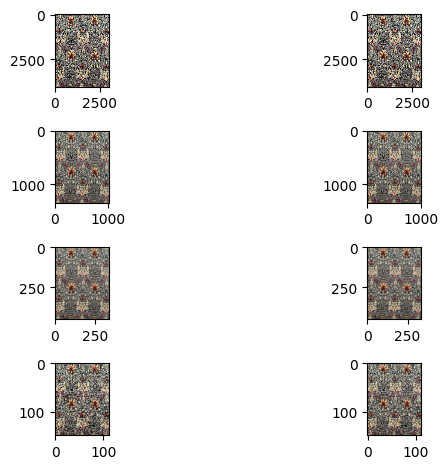

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


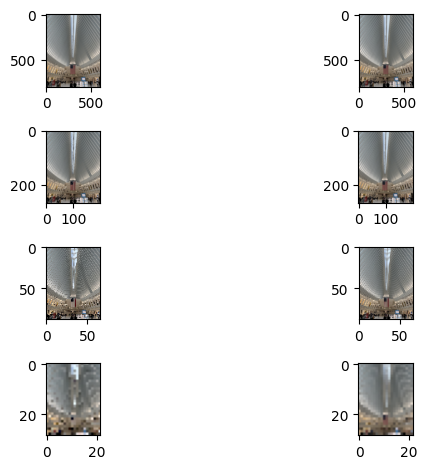

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


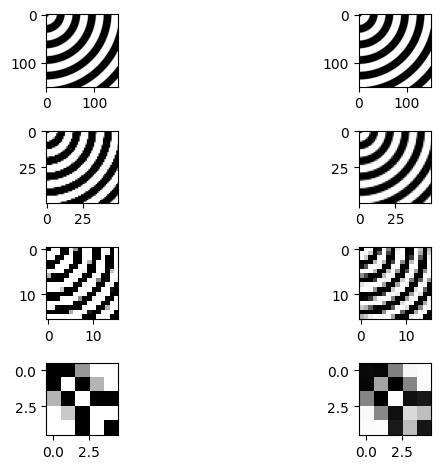

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


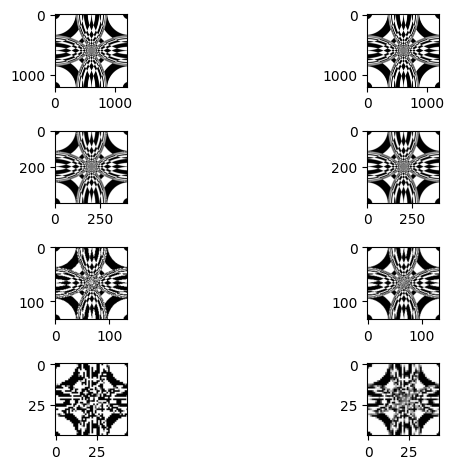

In [31]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Binomial decimation'
IMAGES = ['chicago_fabric.png', 'nyc_intercambiador_crop.png',
		'img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png',
		'img_1200x1200_1x8bit_T01L01_GRAY_grid_circles_progressive_b.png']
PARAMS = [3, 9, 27]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Create the two lists to store the images.
	decms = [org_img.copy()]
	convs = [org_img.copy()]

	for sz in (PARAMS):

		# Just decimate to test.
		dec_img = decimate(org_img, sz)
		decms += [dec_img.copy()]

		# Apply the filter and then decimate.
		fil_img = binomial_filter(org_img, sz)
		fil_img = decimate(fil_img, sz)
		convs += [fil_img.copy()]

		# Store it.
		store_picture(dec_img.copy(), PART, FILTER_NAME, num, val='dec_{}'.format(sz))

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='conv_{}'.format(sz))

	# Display them.
	display_photos_8(decms[0], convs[0], decms[1], convs[1], decms[2], convs[2], decms[3], convs[3])

### Gaussian decimation

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


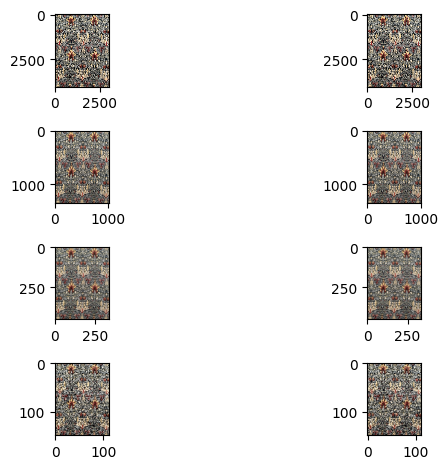

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


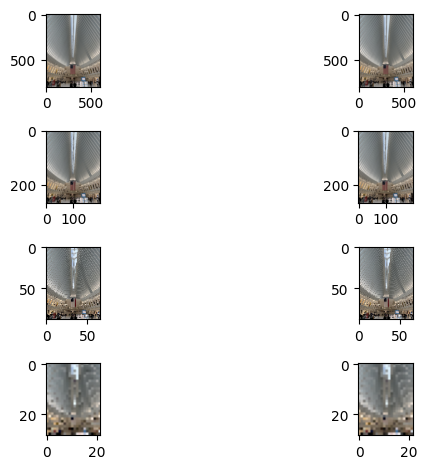

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


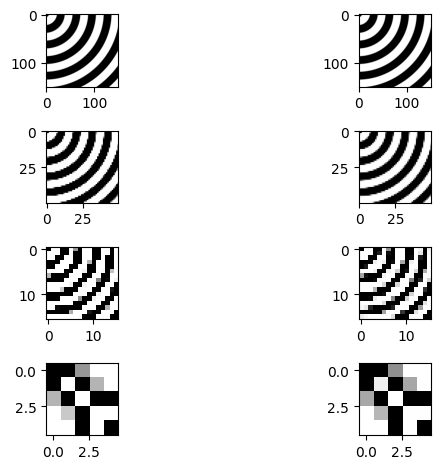

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


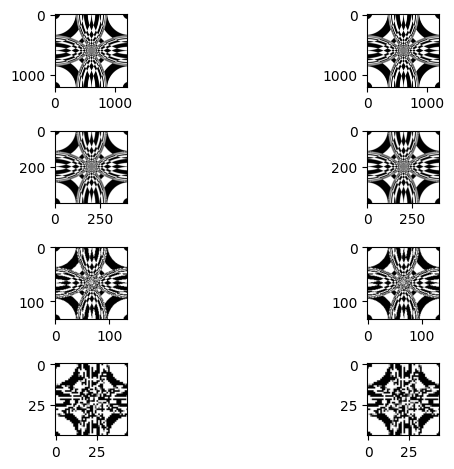

In [32]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Gaussian decimation'
IMAGES = ['chicago_fabric.png', 'nyc_intercambiador_crop.png',
		'img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png',
		'img_1200x1200_1x8bit_T01L01_GRAY_grid_circles_progressive_b.png']
PARAMS = [3, 9, 27]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	# Create the two lists to store the images.
	decms = [org_img.copy()]
	convs = [org_img.copy()]

	for sz in (PARAMS):

		# Just decimate to test.
		dec_img = decimate(org_img, sz)
		decms += [dec_img.copy()]

		# Apply the filter and then decimate.
		fil_img = gaussian_blur(org_img, sz, sz, 0.5)
		fil_img = decimate(fil_img, sz)
		convs += [fil_img.copy()]

		# Store it.
		store_picture(dec_img.copy(), PART, FILTER_NAME, num, val='dec_{}'.format(sz))

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='conv_{}'.format(sz))

	# Display them.
	display_photos_8(decms[0], convs[0], decms[1], convs[1], decms[2], convs[2], decms[3], convs[3])

### Linear interpolation

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


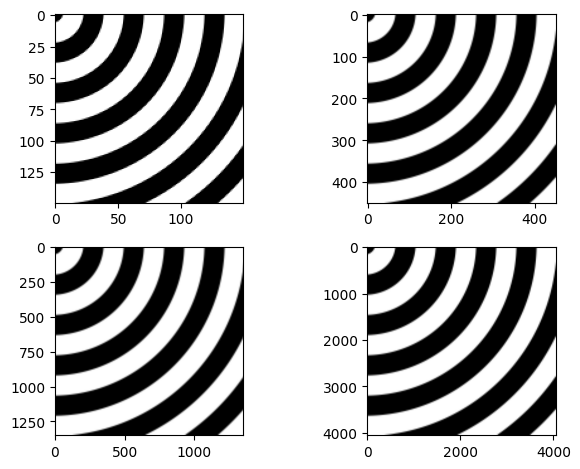

[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]
[Convolved all kernel cells]


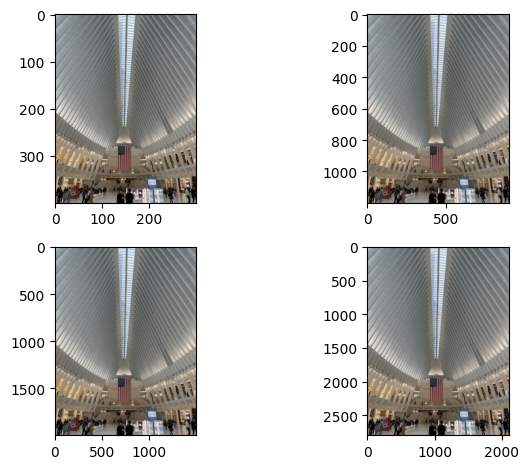

In [33]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Linear interpolation'
IMAGES = ['img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png', 'nyc_intercambiador_crop_more.png']
PARAMS = [[3, 9, 27], [3, 5, 7]]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	pics = [org_img.copy()]

	for sz in (PARAMS[num]):

		# Apply the filter and then decimate.
		fil_img = upscale(org_img, sz)
		fil_img = median_filter(fil_img, sz, sz)

		pics += [np.array(fil_img.copy())]

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='{}'.format(sz))

	# Display them.
	display_photos_4(pics[0], pics[1], pics[2], pics[3])

### Bilateral interpolation

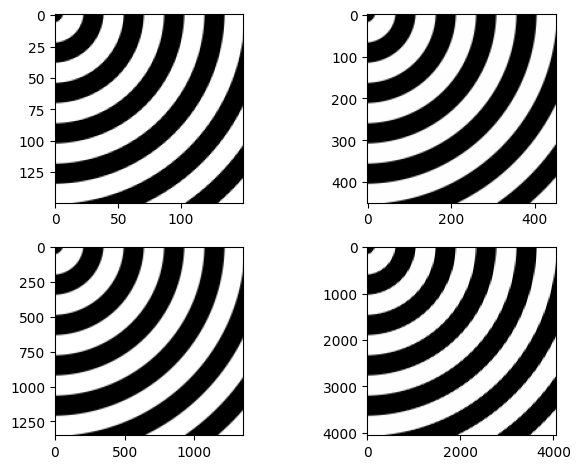

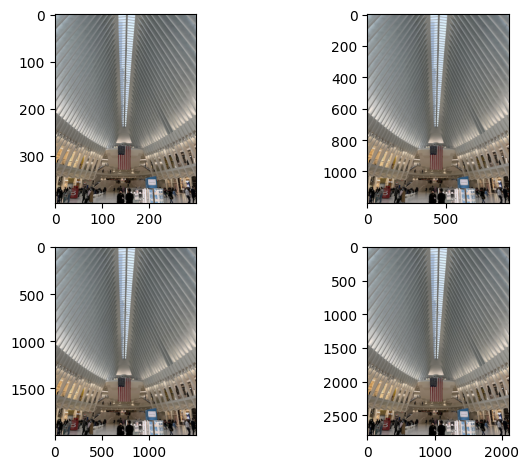

In [34]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Bilateral interpolation'
IMAGES = ['img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png', 'nyc_intercambiador_crop_more.png']
PARAMS = [[3, 9, 27], [3, 5, 7]]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	pics = [org_img.copy()]

	for sz in PARAMS[num]:

		# Apply the filter and then decimate.
		fil_img = upscale(org_img, sz)

		channels = split_channels(fil_img)
		channels = [bilateral_filter(c, sz, sz, sz/2) for c in channels]
		fil_img = merge_channels(channels)

		pics += [np.array(fil_img.copy())]

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='{}'.format(sz))

	# Display them.
	display_photos_4(pics[0], pics[1], pics[2], pics[3])

### Nearest neighbour interpolation.

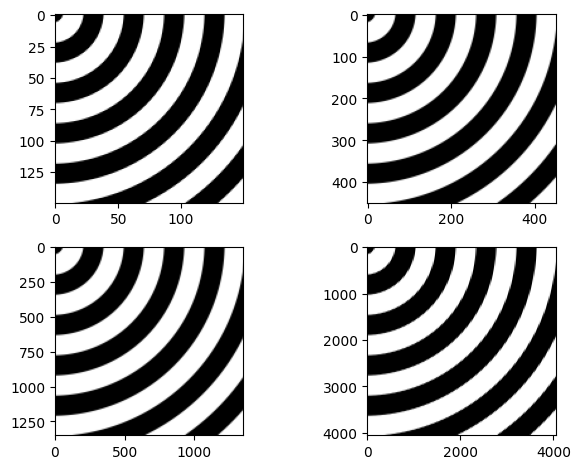

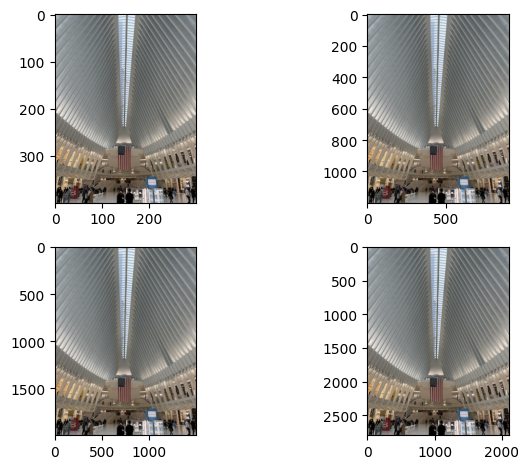

In [35]:
# Get the information for this experiment.
PART = 3
FILTER_NAME = 'Nearest neighbours'
IMAGES = ['img_150x150_1x8bit_B01R03_GRAY_circles_corner_tl_0256.png', 'nyc_intercambiador_crop_more.png']
PARAMS = [[3, 9, 27], [3, 5, 7]]

# Iterate through the images to get them all.
for num, img_filename in enumerate(IMAGES):
	
	# Read the picture.
	org_img = cv2.imread(PICS_DIR + img_filename, 1)
	org_img = color_bgr_to_rgb(org_img) # CV2 uses BGR, we want RGB. Convert it.

	pics = [org_img.copy()]

	for sz in PARAMS[num]:

		# Apply the filter and then decimate.
		fil_img = upscale(org_img, sz)

		pics += [np.array(fil_img.copy())]

		# Store it.
		store_picture(fil_img.copy(), PART, FILTER_NAME, num, val='{}'.format(sz))

	# Display them.
	display_photos_4(pics[0], pics[1], pics[2], pics[3])